In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import numpy as np
import random
from PIL import Image
import matplotlib.pyplot as plt
from math import floor


def zero():
    return np.random.uniform(0.0, 0.01, size = [1])

def one():
    return np.random.uniform(0.99, 1.0, size = [1])

def noise(n):
    return np.random.uniform(-1.0, 1.0, size = [n, 4096])

In [ ]:
import glob

!unzip -u "/content/gdrive/MyDrive/research-project/dilbert-stuff/resized.zip" -d "/content/resized"

images_list = glob.glob('/content/resized/resized/*')

save_directory = "/content/gdrive/MyDrive/research-project/dilbert-stuff/256-results/"

Archive:  /content/gdrive/MyDrive/research-project/dilbert-stuff/resized.zip
   creating: /content/resized/resized/
  inflating: /content/resized/resized/2008-10-12_0.png  
  inflating: /content/resized/resized/2008-07-14_0.png  
  inflating: /content/resized/resized/2010-08-08_6.png  
  inflating: /content/resized/resized/2008-11-12_0.png  
  inflating: /content/resized/resized/2008-06-14_0.png  
  inflating: /content/resized/resized/2007-09-02_6.png  
  inflating: /content/resized/resized/2010-05-16_7.png  
  inflating: /content/resized/resized/2008-01-11_1.png  
  inflating: /content/resized/resized/2010-11-19_1.png  
  inflating: /content/resized/resized/2009-03-08_1.png  
  inflating: /content/resized/resized/2008-08-03_7.png  
  inflating: /content/resized/resized/2009-09-13_1.png  
  inflating: /content/resized/resized/2007-10-13_1.png  
  inflating: /content/resized/resized/2007-07-15_1.png  
  inflating: /content/resized/resized/2010-10-19_1.png  
  inflating: /content/resized

In [ ]:
print("Importing Images...")

Images = []

for i, file_name in enumerate(images_list):

    if i % 100 == 0:
        print(str(i) + " out of " + str(len(images_list)) +  " images processed and imported")
    temp1 = Image.open(file_name)

    temp = np.array(temp1.convert('RGB'), dtype='float32')

    Images.append(temp / 255)

    # some augmentation
    Images.append(np.flip(Images[-1], 1))

# for n in range(1, 721):
#     temp1 = Image.open("Sprites/im ("+str(n)+").png")
                
#     temp = np.array(temp1.convert('RGB'), dtype='float32')
    
#     Images.append(temp / 255)
    
#     Images.append(np.flip(Images[-1], 1))

Importing Images...
0 out of 4625 images processed and imported
100 out of 4625 images processed and imported
200 out of 4625 images processed and imported
300 out of 4625 images processed and imported
400 out of 4625 images processed and imported
500 out of 4625 images processed and imported
600 out of 4625 images processed and imported
700 out of 4625 images processed and imported
800 out of 4625 images processed and imported
900 out of 4625 images processed and imported
1000 out of 4625 images processed and imported
1100 out of 4625 images processed and imported
1200 out of 4625 images processed and imported
1300 out of 4625 images processed and imported
1400 out of 4625 images processed and imported
1500 out of 4625 images processed and imported
1600 out of 4625 images processed and imported
1700 out of 4625 images processed and imported
1800 out of 4625 images processed and imported
1900 out of 4625 images processed and imported
2000 out of 4625 images processed and imported
2100 

In [ ]:
from keras.layers import Conv2D, LeakyReLU, BatchNormalization, Dense, AveragePooling2D
from keras.layers import Reshape, UpSampling2D, Activation, Dropout, Flatten, Conv2DTranspose
from keras.models import model_from_json, Sequential
from keras.optimizers import Adam

In [ ]:
class GAN(object):
    
    def __init__(self):
        
        #Models
        self.D = None
        self.G = None
        
        self.OD = None
        
        self.DM = None
        self.AM = None
        
        #Config
        self.LR = 0.0001
        self.steps = 1

    def discriminator(self):
        
        if self.D:
            return self.D
        
        self.D = Sequential()
        
        
        #256x256x3 Image
        self.D.add(Conv2D(filters = 8, kernel_size = 3, padding = 'same', input_shape = [256, 256, 3]))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())
        
        #128x128x8
        self.D.add(Conv2D(filters = 16, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())
        
        #64x64x16
        self.D.add(Conv2D(filters = 32, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())
        
        #32x32x32
        self.D.add(Conv2D(filters = 64, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())
        
        #16x16x64
        self.D.add(Conv2D(filters = 128, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())
        
        #8x8x128
        self.D.add(Conv2D(filters = 256, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())
        
        #4x4x256
        self.D.add(Flatten())
        
        #256
        self.D.add(Dense(128))
        self.D.add(LeakyReLU(0.2))
        
        self.D.add(Dense(1, activation = 'sigmoid'))
        
        return self.D
    
    def generator(self):
        
        if self.G:
            return self.G
        
        self.G = Sequential()
        
        self.G.add(Reshape(target_shape = [1, 1, 4096], input_shape = [4096]))
        
        #1x1x4096
        self.G.add(Conv2DTranspose(filters = 512, kernel_size = 4))
        self.G.add(Activation('relu'))
        
        #4x4x256
        self.G.add(Conv2D(filters = 256, kernel_size = 3, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())
        
        #8x8x256
        self.G.add(Conv2D(filters = 128, kernel_size = 3, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())
        
        #16x16x128
        self.G.add(Conv2D(filters = 64, kernel_size = 3, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())
        
        #32x32x64
        self.G.add(Conv2D(filters = 32, kernel_size = 3, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())
        
        #64x64x32
        self.G.add(Conv2D(filters = 16, kernel_size = 3, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())
        
        #128x128x16
        self.G.add(Conv2D(filters = 8, kernel_size = 3, padding = 'same'))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())
        
        #256x256x8
        self.G.add(Conv2D(filters = 3, kernel_size = 3, padding = 'same'))
        self.G.add(Activation('sigmoid'))
        
        return self.G
    
    def DisModel(self):
        
        if self.DM == None:
            self.DM = Sequential()
            self.DM.add(self.discriminator())
        
        self.DM.compile(optimizer = Adam(lr = self.LR * (0.85 ** floor(self.steps / 10000))), loss = 'binary_crossentropy')
        
        return self.DM
    
    def AdModel(self):
        
        if self.AM == None:
            self.AM = Sequential()
            self.AM.add(self.generator())
            self.AM.add(self.discriminator())
            
        self.AM.compile(optimizer = Adam(lr = self.LR * (0.85 ** floor(self.steps / 10000))), loss = 'binary_crossentropy')
        
        return self.AM
    
    def sod(self):
        
        self.OD = self.D.get_weights()
        
    def lod(self):
        
        self.D.set_weights(self.OD)

In [ ]:
class Model_GAN(object):
    
    def __init__(self):
        
        self.GAN = GAN()
        self.DisModel = self.GAN.DisModel()
        self.AdModel = self.GAN.AdModel()
        self.generator = self.GAN.generator()

        
    def train(self, batch = 16):
        
        (a, b) = self.train_dis(batch)
        c = self.train_gen(batch)
        
        if self.GAN.steps % 100 == 0:

            print("D Real: " + str(a))
            print("D Fake: " + str(b))
            print("G All:: " + str(c))
        
        if self.GAN.steps % 1000 == 0:
            self.save(floor(self.GAN.steps / 10000))
            self.evaluate()
            
        if self.GAN.steps % 5000 == 0:
            self.GAN.AM = None
            self.GAN.DM = None
            self.AdModel = self.GAN.AdModel()
            self.DisModel = self.GAN.DisModel()
        
        self.GAN.steps = self.GAN.steps + 1
        
    def train_dis(self, batch):
        
        #Get Real Images
        im_no = random.randint(0, len(Images) - batch - 1)
        train_data = Images[im_no : im_no + int(batch / 2)]
        label_data = []
        for i in range(int(batch / 2)):
            label_data.append(one())
            
        d_loss_real = self.DisModel.train_on_batch(np.array(train_data), np.array(label_data))
        
        #Get Fake Images
        train_data = self.generator.predict(noise(int(batch / 2)))
        label_data = []
        for i in range(int(batch / 2)):
            label_data.append(zero())
            
        d_loss_fake = self.DisModel.train_on_batch(train_data, np.array(label_data))
        
        return (d_loss_real, d_loss_fake)
        
    def train_gen(self, batch):
        
        self.GAN.sod()
        
        label_data = []
        for i in range(int(batch)):
            label_data.append(one())
        
        g_loss = self.AdModel.train_on_batch(noise(batch), np.array(label_data))
        
        self.GAN.lod()
        
        return g_loss
        
    def evaluate(self):
        
        im_no = random.randint(0, len(Images) - 1)
        im1 = Images[im_no]
        
        im2 = self.generator.predict(noise(2))
        
        plt.figure(1)
        plt.imshow(im1)
        
        plt.figure(2)
        plt.imshow(im2[0])
        
        plt.figure(3)
        plt.imshow(im2[1])
        
        plt.show()
        
    def save(self, num):
        gen_json = self.GAN.G.to_json()
        dis_json = self.GAN.D.to_json()

        with open(save_directory + "Models/gen.json", "w") as json_file:
            json_file.write(gen_json)

        with open(save_directory + "Models/dis.json", "w") as json_file:
            json_file.write(dis_json)

        self.GAN.G.save_weights(save_directory + "Models/gen"+str(num)+".h5")
        self.GAN.D.save_weights(save_directory + "Models/dis"+str(num)+".h5")

        #print("Saved!")

    def load(self, num):
        steps1 = self.GAN.steps
        
        self.GAN = None
        self.GAN = GAN()

        #Generator
        gen_file = open(save_directory + "Models/gen.json", 'r')
        gen_json = gen_file.read()
        gen_file.close()
        
        self.GAN.G = model_from_json(gen_json)
        self.GAN.G.load_weights(save_directory + "Models/gen"+str(num)+".h5")

        #Discriminator
        dis_file = open(save_directory + "Models/dis.json", 'r')
        dis_json = dis_file.read()
        dis_file.close()
        
        self.GAN.D = model_from_json(dis_json)
        self.GAN.D.load_weights(save_directory + "Models/dis"+str(num)+".h5")

        #Reinitialize
        self.generator = self.GAN.generator()
        self.DisModel = self.GAN.DisModel()
        self.AdModel = self.GAN.AdModel()
        
        self.GAN.steps = steps1
        
    def eval2(self, num = 0):
        
        im2 = self.generator.predict(noise(48))
        
        r1 = np.concatenate(im2[:8], axis = 1)
        r2 = np.concatenate(im2[8:16], axis = 1)
        r3 = np.concatenate(im2[16:24], axis = 1)
        r4 = np.concatenate(im2[24:32], axis = 1)
        r5 = np.concatenate(im2[32:40], axis = 1)
        r6 = np.concatenate(im2[40:48], axis = 1)
        
        c1 = np.concatenate([r1, r2, r3, r4, r5, r6], axis = 0)
        
        x = Image.fromarray(np.uint8(c1*255))
        
        
        x.save(save_directory+str(num)+".png")


In [ ]:
class Model_GAN_epochs(object):
    
    def __init__(self):
        
        self.GAN = GAN()
        self.DisModel = self.GAN.DisModel()
        self.AdModel = self.GAN.AdModel()
        self.generator = self.GAN.generator()
        self.epoch = 0

        self.d_real_loss = []
        self.d_fake_loss = []
        self.g_loss = []

    def train(self, batch = 64):

        d_real_loss_batch = []
        d_fake_loss_batch = []
        g_loss_batch = []
        
        for b in range(0, floor(len(Images)/(batch/2))-2):

            (a, b) = self.train_dis_e(batch, b)
            c = self.train_gen(batch)

            d_real_loss_batch.append(a)
            d_fake_loss_batch.append(b)
            g_loss_batch.append(c)

            self.GAN.steps = self.GAN.steps + 1

        self.d_real_loss.append(np.mean(d_real_loss_batch))
        self.d_fake_loss.append(np.mean(d_fake_loss_batch))
        self.g_loss.append(np.mean(g_loss_batch))
        # (a, b) = self.train_dis(batch)
        # c = self.train_gen(batch)
        

        print("D Real: " + str(self.d_real_loss[-1]))
        print("D Fake: " + str(self.d_fake_loss[-1]))
        print("G All:: " + str(self.g_loss[-1]))
        
        # if self.GAN.steps % 1000 == 0:
        #     self.save(floor(self.GAN.steps / 10000))
        #     self.evaluate()

        if self.epoch % 10 == 0:
            self.save(self.epoch)
            self.eval2()
        self.evaluate()
            
        # if self.GAN.steps % 5000 == 0:
        #     self.GAN.AM = None
        #     self.GAN.DM = None
        #     self.AdModel = self.GAN.AdModel()
        #     self.DisModel = self.GAN.DisModel()
        if self.epoch % 2 == 0:
            self.GAN.AM = None
            self.GAN.DM = None
            self.AdModel = self.GAN.AdModel()
            self.DisModel = self.GAN.DisModel()
        
        
        
    
    def train_dis_e(self, batch, b_no):
        
        #Get Real Images
        # im_no = random.randint(0, len(Images) - batch - 1)

        batch_index = int(b_no * batch/2)
        train_data = Images[batch_index : batch_index + int(batch / 2)]
        label_data = []
        for i in range(int(batch / 2)):
            label_data.append(one())
            
        d_loss_real = self.DisModel.train_on_batch(np.array(train_data), np.array(label_data))
        
        #Get Fake Images
        train_data = self.generator.predict(noise(int(batch / 2)))
        label_data = []
        for i in range(int(batch / 2)):
            label_data.append(zero())
            
        d_loss_fake = self.DisModel.train_on_batch(train_data, np.array(label_data))
        
        return (d_loss_real, d_loss_fake)

    def train_gen(self, batch):
        
        self.GAN.sod()
        
        label_data = []
        for i in range(int(batch)):
            label_data.append(one())
        
        g_loss = self.AdModel.train_on_batch(noise(batch), np.array(label_data))
        
        self.GAN.lod()
        
        return g_loss
        
    def evaluate(self):
        
        im_no = random.randint(0, len(Images) - 1)
        im1 = Images[im_no]
        
        im2 = self.generator.predict(noise(2))
        
        plt.figure(1)
        plt.imshow(im1)
        
        plt.figure(2)
        plt.imshow(im2[0])
        
        plt.figure(3)
        plt.imshow(im2[1])
        
        plt.show()
        
    def save(self, num):
        gen_json = self.GAN.G.to_json()
        dis_json = self.GAN.D.to_json()

        with open(save_directory + "Models/gen_e.json", "w") as json_file:
            json_file.write(gen_json)

        with open(save_directory + "Models/dis_e.json", "w") as json_file:
            json_file.write(dis_json)

        self.GAN.G.save_weights(save_directory + "Models/gen_e"+str(num)+".h5")
        self.GAN.D.save_weights(save_directory + "Models/dis_e"+str(num)+".h5")

        #print("Saved!")

    def load(self, num):
        steps1 = self.GAN.steps
        
        self.GAN = None
        self.GAN = GAN()

        #Generator
        gen_file = open(save_directory + "Models/gen_e.json", 'r')
        gen_json = gen_file.read()
        gen_file.close()
        
        self.GAN.G = model_from_json(gen_json)
        self.GAN.G.load_weights(save_directory + "Models/gen_e"+str(num)+".h5")

        #Discriminator
        dis_file = open(save_directory + "Models/dis_e.json", 'r')
        dis_json = dis_file.read()
        dis_file.close()
        
        self.GAN.D = model_from_json(dis_json)
        self.GAN.D.load_weights(save_directory + "Models/dis_e"+str(num)+".h5")

        #Reinitialize
        self.generator = self.GAN.generator()
        self.DisModel = self.GAN.DisModel()
        self.AdModel = self.GAN.AdModel()
        
        self.GAN.steps = steps1
        
    def eval2(self, num = 0):
        
        im2 = self.generator.predict(noise(48))
        
        r1 = np.concatenate(im2[:8], axis = 1)
        r2 = np.concatenate(im2[8:16], axis = 1)
        r3 = np.concatenate(im2[16:24], axis = 1)
        r4 = np.concatenate(im2[24:32], axis = 1)
        r5 = np.concatenate(im2[32:40], axis = 1)
        r6 = np.concatenate(im2[40:48], axis = 1)
        
        c1 = np.concatenate([r1, r2, r3, r4, r5, r6], axis = 0)
        
        x = Image.fromarray(np.uint8(c1*255))
        
        
        x.save(save_directory+str(num)+".png")

We're off! See you in a while!
D Real: 0.03698839992284775
D Fake: 0.08879341185092926
G All:: 5.262652397155762
D Real: 0.059937067329883575
D Fake: 0.03691272437572479
G All:: 7.907683372497559
D Real: 0.04869230091571808
D Fake: 0.03707759454846382
G All:: 7.411134719848633
D Real: 0.047664571553468704
D Fake: 0.04205537587404251
G All:: 5.740200996398926
D Real: 0.03962579369544983
D Fake: 0.14182904362678528
G All:: 5.608415603637695
D Real: 0.019721591845154762
D Fake: 0.057569898664951324
G All:: 9.815296173095703
D Real: 0.06927789747714996
D Fake: 0.06273163855075836
G All:: 4.403241157531738




Round 52000:
D Real: 0.046314653009176254
D Fake: 0.04133367910981178
G All:: 5.010575294494629


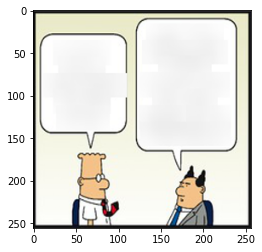

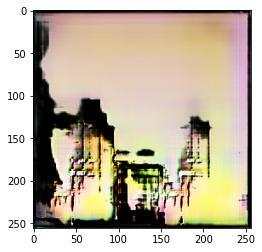

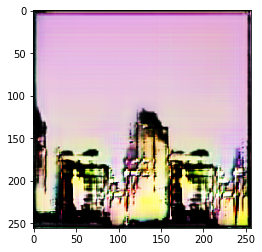

D Real: 0.02271481603384018
D Fake: 0.03496182709932327
G All:: 4.451257705688477
D Real: 0.0387030765414238
D Fake: 0.04037124291062355
G All:: 4.048130989074707
D Real: 0.05245252326130867
D Fake: 0.03367394953966141
G All:: 6.108074188232422
D Real: 0.02642121911048889
D Fake: 0.02664065733551979
G All:: 6.5889692306518555
D Real: 0.04281139373779297
D Fake: 0.07156173139810562
G All:: 2.1223819255828857
D Real: 0.034638457000255585
D Fake: 0.03479960188269615
G All:: 6.456516742706299
D Real: 0.27712827920913696
D Fake: 0.04119385778903961
G All:: 7.399274826049805
D Real: 0.03952612355351448
D Fake: 0.06949228793382645
G All:: 5.259620666503906
D Real: 0.04395277053117752
D Fake: 0.05852213874459267
G All:: 2.088456869125366




Round 53000:
D Real: 0.04564213752746582
D Fake: 0.03581204265356064
G All:: 6.194607734680176


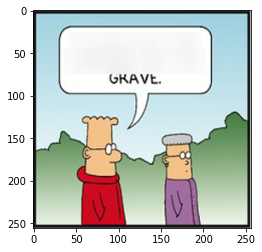

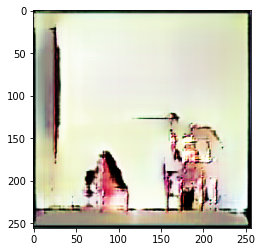

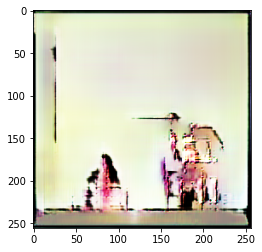

D Real: 0.0378834530711174
D Fake: 0.022176295518875122
G All:: 6.275364875793457
D Real: 0.03886604309082031
D Fake: 0.043551694601774216
G All:: 5.218208312988281
D Real: 0.042577993124723434
D Fake: 0.04424677789211273
G All:: 5.484445571899414
D Real: 0.03670812398195267
D Fake: 0.026256132870912552
G All:: 6.6023054122924805
D Real: 0.0410006120800972
D Fake: 0.029295049607753754
G All:: 6.820721626281738
D Real: 0.06388383358716965
D Fake: 0.0503845177590847
G All:: 6.6202473640441895
D Real: 0.04495055973529816
D Fake: 0.05179155617952347
G All:: 4.321652412414551
D Real: 0.02764628827571869
D Fake: 0.028930973261594772
G All:: 6.803569793701172
D Real: 0.04711465537548065
D Fake: 0.03831348568201065
G All:: 6.2803497314453125




Round 54000:
D Real: 0.4862513542175293
D Fake: 0.02703091688454151
G All:: 3.885571002960205


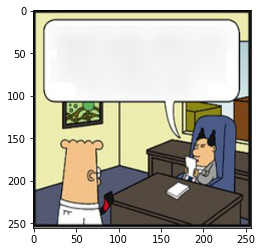

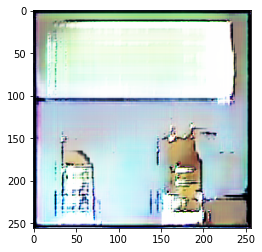

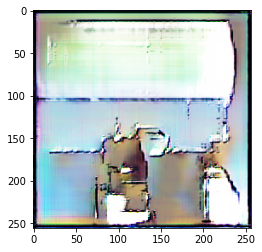

D Real: 0.03168652951717377
D Fake: 0.057868245989084244
G All:: 3.46054744720459
D Real: 0.03935355693101883
D Fake: 0.03255792707204819
G All:: 5.278628826141357
D Real: 0.05606897920370102
D Fake: 0.03970370441675186
G All:: 6.602409362792969
D Real: 0.036522276699543
D Fake: 0.025329532101750374
G All:: 8.465386390686035
D Real: 0.059302832931280136
D Fake: 0.04149613529443741
G All:: 5.24092435836792
D Real: 0.048237111419439316
D Fake: 0.03215733543038368
G All:: 5.673050880432129
D Real: 0.029084844514727592
D Fake: 0.03801697865128517
G All:: 5.2628631591796875
D Real: 0.03184981644153595
D Fake: 0.040251389145851135
G All:: 5.358999252319336
D Real: 0.037560224533081055
D Fake: 0.061894942075014114
G All:: 5.033478736877441




Round 55000:
D Real: 0.039470139890909195
D Fake: 0.04520759359002113
G All:: 6.6568450927734375


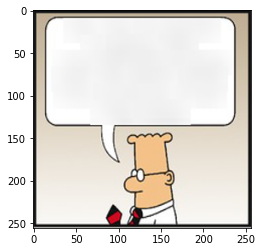

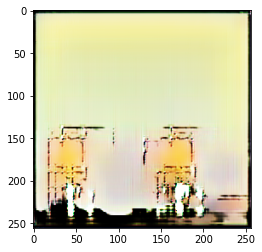

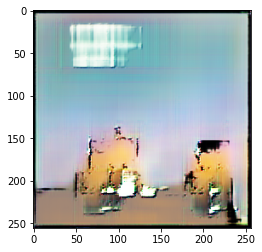

D Real: 0.03785593807697296
D Fake: 0.046750687062740326
G All:: 5.331007480621338
D Real: 0.020559027791023254
D Fake: 0.028703926131129265
G All:: 7.94437313079834
D Real: 0.050570107996463776
D Fake: 0.05054730176925659
G All:: 6.081171035766602
D Real: 0.030732590705156326
D Fake: 0.039448607712984085
G All:: 5.389224052429199
D Real: 0.033271681517362595
D Fake: 0.04339092969894409
G All:: 5.439461708068848
D Real: 0.038488999009132385
D Fake: 0.03868885338306427
G All:: 5.847818374633789
D Real: 0.024637967348098755
D Fake: 0.03793811798095703
G All:: 5.712642669677734
D Real: 0.04587562754750252
D Fake: 0.036645952612161636
G All:: 6.229920387268066
D Real: 0.03892791271209717
D Fake: 0.042094163596630096
G All:: 5.058467388153076




Round 56000:
D Real: 0.039427317678928375
D Fake: 0.045830003917217255
G All:: 5.804003715515137


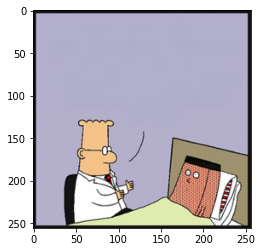

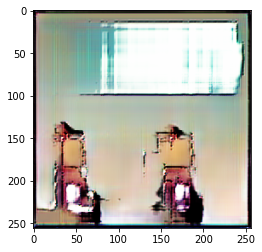

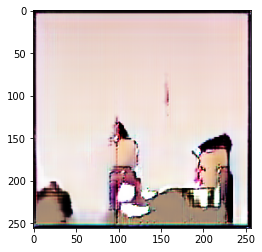

D Real: 0.022524068132042885
D Fake: 0.027004610747098923
G All:: 4.9640984535217285
D Real: 0.03873544931411743
D Fake: 0.03468208760023117
G All:: 4.289236068725586
D Real: 0.03234674036502838
D Fake: 0.03675893321633339
G All:: 5.221526145935059
D Real: 0.031009119004011154
D Fake: 0.040415260940790176
G All:: 5.102787017822266
D Real: 0.04860402271151543
D Fake: 0.03647688031196594
G All:: 5.77759313583374
D Real: 0.027474528178572655
D Fake: 0.028240926563739777
G All:: 6.02418851852417
D Real: 0.03399931639432907
D Fake: 0.028349101543426514
G All:: 5.829627990722656
D Real: 0.04631789028644562
D Fake: 0.03723440319299698
G All:: 7.0349578857421875
D Real: 0.041522540152072906
D Fake: 0.046835195273160934
G All:: 5.52269172668457




Round 57000:
D Real: 0.042868055403232574
D Fake: 0.04437136650085449
G All:: 7.296541213989258


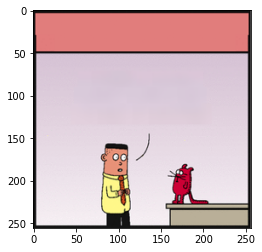

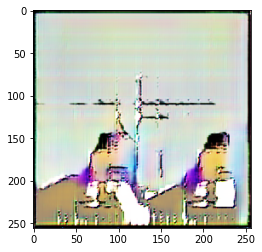

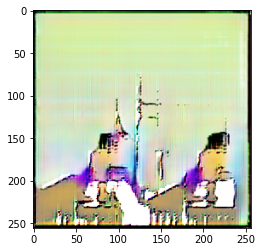

D Real: 0.05463814362883568
D Fake: 0.04072420299053192
G All:: 5.2480010986328125
D Real: 0.05464111641049385
D Fake: 0.035886988043785095
G All:: 6.176491737365723
D Real: 0.03304162621498108
D Fake: 0.05633322894573212
G All:: 4.5001115798950195
D Real: 0.028706008568406105
D Fake: 0.040659643709659576
G All:: 6.2436065673828125
D Real: 0.03343909606337547
D Fake: 0.038537170737981796
G All:: 4.014362335205078
D Real: 0.05393718183040619
D Fake: 0.03757832571864128
G All:: 6.361997604370117
D Real: 0.03605378046631813
D Fake: 0.03128283470869064
G All:: 4.011361122131348
D Real: 0.04792744666337967
D Fake: 0.04040060192346573
G All:: 5.680881500244141
D Real: 0.032935962080955505
D Fake: 0.03805620223283768
G All:: 5.013073921203613




Round 58000:
D Real: 0.044657833874225616
D Fake: 0.0490989051759243
G All:: 5.131529808044434


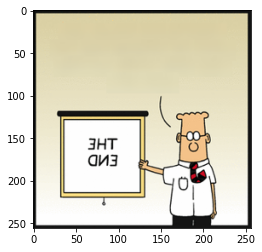

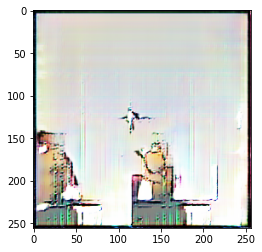

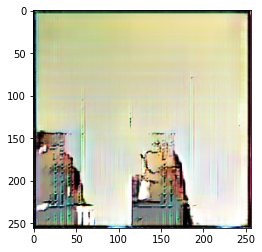

D Real: 0.033746588975191116
D Fake: 0.02106885239481926
G All:: 6.2165303230285645
D Real: 0.040459249168634415
D Fake: 0.04155337065458298
G All:: 5.207461357116699
D Real: 0.03313109651207924
D Fake: 0.0337703675031662
G All:: 5.388152599334717
D Real: 0.025688763707876205
D Fake: 0.0543350912630558
G All:: 4.444794178009033
D Real: 0.024574218317866325
D Fake: 0.03946927562355995
G All:: 7.811161518096924
D Real: 0.04834529757499695
D Fake: 0.05925595387816429
G All:: 5.239243507385254
D Real: 0.0349261611700058
D Fake: 0.040346965193748474
G All:: 5.412588119506836
D Real: 0.03330131620168686
D Fake: 0.047141123563051224
G All:: 5.343214988708496
D Real: 0.028076529502868652
D Fake: 0.04766246676445007
G All:: 6.280051231384277




Round 59000:
D Real: 0.028863143175840378
D Fake: 0.02960151806473732
G All:: 7.4209442138671875


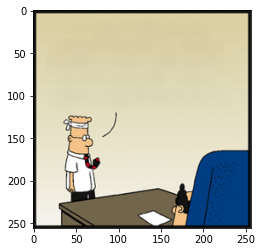

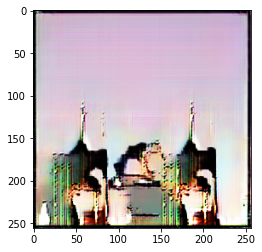

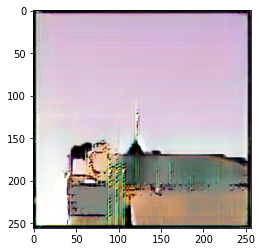

D Real: 0.04864063486456871
D Fake: 0.040884312242269516
G All:: 6.5462646484375
D Real: 0.019896572455763817
D Fake: 0.050960563123226166
G All:: 9.341497421264648
D Real: 0.035856351256370544
D Fake: 0.02745993621647358
G All:: 6.4896697998046875
D Real: 0.03351965919137001
D Fake: 0.03944557160139084
G All:: 5.882539749145508
D Real: 0.039837546646595
D Fake: 0.03563553839921951
G All:: 7.048650741577148
D Real: 0.0430484414100647
D Fake: 0.03533327206969261
G All:: 7.048537254333496
D Real: 0.04135224595665932
D Fake: 0.03366578370332718
G All:: 5.407780170440674
D Real: 0.04324498772621155
D Fake: 0.03112686425447464
G All:: 6.346737861633301
D Real: 0.0343393012881279
D Fake: 0.04127587005496025
G All:: 4.368424415588379




Round 60000:
D Real: 0.040906872600317
D Fake: 0.04194255918264389
G All:: 6.483841896057129


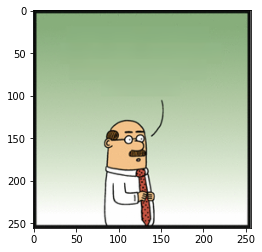

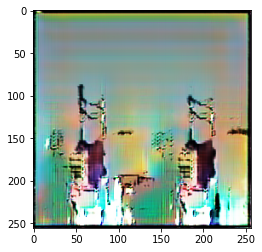

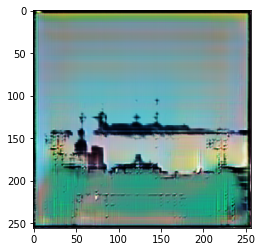

D Real: 0.022898195311427116
D Fake: 0.045203737914562225
G All:: 6.154979705810547
D Real: 0.03322305530309677
D Fake: 0.03741932287812233
G All:: 5.226053237915039
D Real: 0.04021195322275162
D Fake: 0.029811471700668335
G All:: 5.842259883880615
D Real: 0.04195568338036537
D Fake: 0.05183520168066025
G All:: 4.908193588256836
D Real: 0.04135802388191223
D Fake: 0.029294684529304504
G All:: 7.535740852355957
D Real: 0.05376210808753967
D Fake: 0.02958468720316887
G All:: 4.968979835510254
D Real: 0.06208845600485802
D Fake: 0.038772888481616974
G All:: 6.685688018798828
D Real: 0.04172718524932861
D Fake: 0.03453965112566948
G All:: 6.409127235412598
D Real: 0.033003341406583786
D Fake: 0.04001350700855255
G All:: 5.909273147583008




Round 61000:
D Real: 0.04232513904571533
D Fake: 0.049654483795166016
G All:: 6.243679046630859


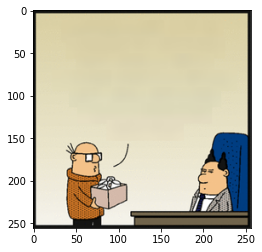

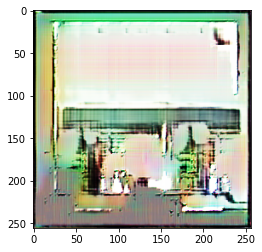

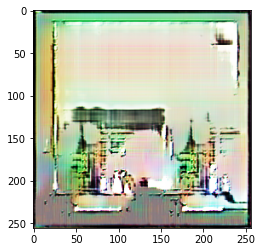

D Real: 0.03594452887773514
D Fake: 0.042297255247831345
G All:: 7.116103649139404
D Real: 0.035438843071460724
D Fake: 0.05514335259795189
G All:: 7.2558441162109375
D Real: 0.10374660789966583
D Fake: 0.028467195108532906
G All:: 6.63772439956665
D Real: 0.06708666682243347
D Fake: 0.032577306032180786
G All:: 8.506959915161133
D Real: 0.08035942912101746
D Fake: 0.0487738773226738
G All:: 7.040019989013672
D Real: 0.03978978097438812
D Fake: 0.028449879959225655
G All:: 5.60374641418457
D Real: 0.02847192995250225
D Fake: 0.030317597091197968
G All:: 5.773681640625
D Real: 0.039736323058605194
D Fake: 0.05650906264781952
G All:: 3.9373576641082764
D Real: 0.03263886272907257
D Fake: 0.061168279498815536
G All:: 5.275127410888672




Round 62000:
D Real: 0.03668900579214096
D Fake: 0.03825537860393524
G All:: 4.609923839569092


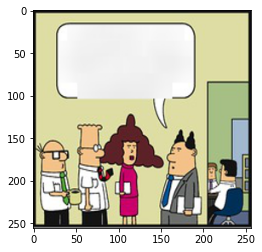

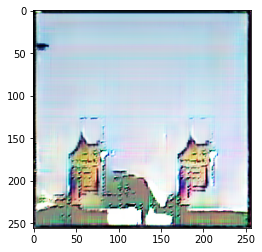

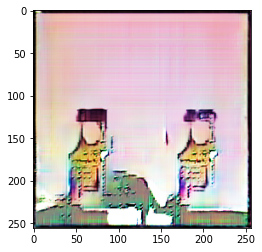

D Real: 0.037244051694869995
D Fake: 0.03924908861517906
G All:: 5.516173362731934
D Real: 0.02553560771048069
D Fake: 0.03392477333545685
G All:: 4.66788387298584
D Real: 0.029289815574884415
D Fake: 0.03456050157546997
G All:: 6.735982894897461
D Real: 0.02932725101709366
D Fake: 0.03806653618812561
G All:: 6.192198753356934
D Real: 0.032800979912281036
D Fake: 0.04150974750518799
G All:: 4.561776161193848
D Real: 0.026467029005289078
D Fake: 0.03741080313920975
G All:: 5.785681247711182
D Real: 0.034738920629024506
D Fake: 0.05188870429992676
G All:: 4.988272666931152
D Real: 0.046601273119449615
D Fake: 0.03165252506732941
G All:: 6.36041259765625
D Real: 0.026774441823363304
D Fake: 0.04177449643611908
G All:: 5.909255027770996




Round 63000:
D Real: 0.04249850660562515
D Fake: 0.042264778167009354
G All:: 5.947012424468994


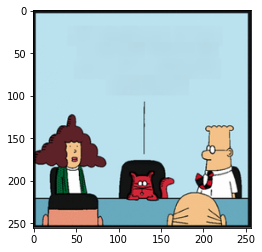

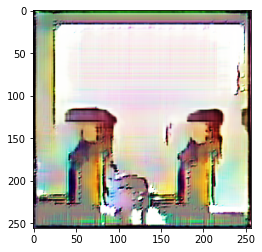

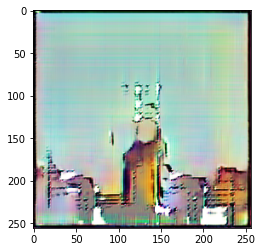

D Real: 0.033315688371658325
D Fake: 0.037762947380542755
G All:: 6.337828636169434
D Real: 0.037704721093177795
D Fake: 0.0526469387114048
G All:: 6.235720157623291
D Real: 0.03576763719320297
D Fake: 0.09376071393489838
G All:: 3.9354066848754883
D Real: 0.0355742946267128
D Fake: 0.020276010036468506
G All:: 6.174184799194336
D Real: 0.038172341883182526
D Fake: 0.03371531888842583
G All:: 5.557860374450684
D Real: 0.03531946986913681
D Fake: 0.05391298234462738
G All:: 6.289813041687012
D Real: 0.05079885572195053
D Fake: 0.025082260370254517
G All:: 6.2063374519348145
D Real: 0.05268675833940506
D Fake: 0.09109991788864136
G All:: 5.146328449249268
D Real: 0.04463064670562744
D Fake: 0.04053070396184921
G All:: 5.936557292938232




Round 64000:
D Real: 0.029581358656287193
D Fake: 0.030777988955378532
G All:: 5.1307196617126465


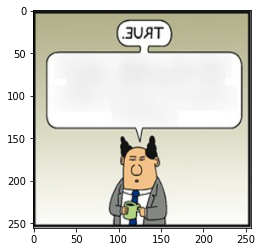

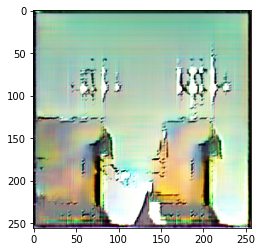

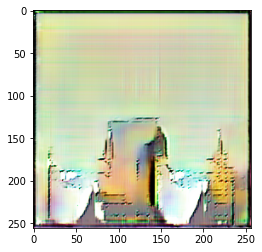

D Real: 0.023308448493480682
D Fake: 0.04059864580631256
G All:: 5.575869560241699
D Real: 0.03793787956237793
D Fake: 0.026254964992403984
G All:: 6.1473822593688965
D Real: 0.04672396183013916
D Fake: 0.03743737190961838
G All:: 5.60609769821167
D Real: 0.04739433899521828
D Fake: 0.04651474580168724
G All:: 6.394340515136719
D Real: 0.025336887687444687
D Fake: 0.048724282532930374
G All:: 7.760865211486816
D Real: 0.03819268196821213
D Fake: 0.03379550576210022
G All:: 4.6707634925842285
D Real: 0.026633750647306442
D Fake: 0.040114834904670715
G All:: 4.975660800933838
D Real: 0.033834658563137054
D Fake: 0.02935551479458809
G All:: 5.524518966674805
D Real: 0.04455910250544548
D Fake: 0.03406227380037308
G All:: 5.313089370727539




Round 65000:
D Real: 0.03748990595340729
D Fake: 0.024464190006256104
G All:: 5.984066009521484


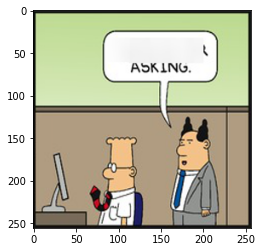

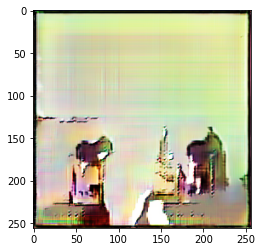

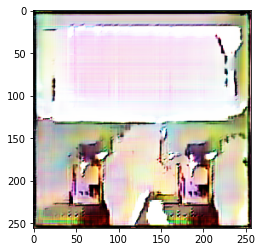

D Real: 0.043938130140304565
D Fake: 0.04508114978671074
G All:: 3.928765296936035
D Real: 0.03939823806285858
D Fake: 0.03582707792520523
G All:: 6.767297267913818
D Real: 0.04127975553274155
D Fake: 0.03513504937291145
G All:: 6.1817426681518555
D Real: 0.04166581109166145
D Fake: 0.03845614939928055
G All:: 5.687736988067627
D Real: 0.03521709516644478
D Fake: 0.04042263329029083
G All:: 6.2620110511779785
D Real: 0.033738985657691956
D Fake: 0.022197002544999123
G All:: 7.105287075042725
D Real: 0.02918832376599312
D Fake: 0.023151271045207977
G All:: 5.720005035400391
D Real: 0.03104512393474579
D Fake: 0.037885040044784546
G All:: 5.445815563201904
D Real: 0.0358041413128376
D Fake: 0.028774674981832504
G All:: 6.136133193969727




Round 66000:
D Real: 0.0433754101395607
D Fake: 0.03370165824890137
G All:: 6.455176830291748


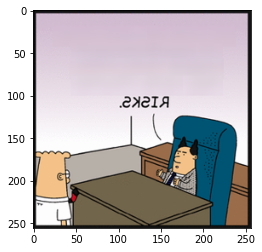

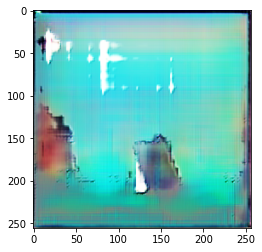

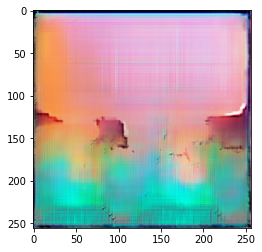

D Real: 0.033327940851449966
D Fake: 0.034328900277614594
G All:: 4.783251762390137
D Real: 0.02504192665219307
D Fake: 0.04339825361967087
G All:: 5.830262184143066
D Real: 0.024088047444820404
D Fake: 0.033114954829216
G All:: 6.210710048675537
D Real: 0.023288682103157043
D Fake: 0.04549107700586319
G All:: 5.978660583496094
D Real: 0.03695407509803772
D Fake: 0.0323595255613327
G All:: 4.360011100769043
D Real: 0.04262986779212952
D Fake: 0.0246688611805439
G All:: 5.384053707122803
D Real: 0.02765684761106968
D Fake: 0.03672035411000252
G All:: 4.6695709228515625
D Real: 0.03521187976002693
D Fake: 0.035866040736436844
G All:: 6.201051712036133
D Real: 0.014912484213709831
D Fake: 0.04839252308011055
G All:: 7.190032005310059




Round 67000:
D Real: 0.02381397783756256
D Fake: 0.031927064061164856
G All:: 7.000805854797363


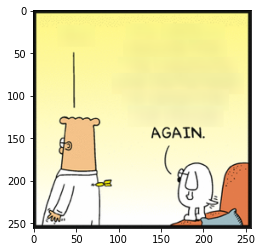

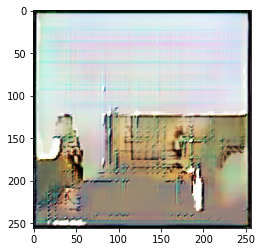

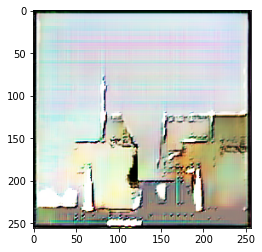

D Real: 0.034083154052495956
D Fake: 0.03369762375950813
G All:: 5.704799175262451
D Real: 0.04964812472462654
D Fake: 0.13983750343322754
G All:: 4.225421905517578
D Real: 0.023479975759983063
D Fake: 0.02522995136678219
G All:: 5.251656532287598
D Real: 0.023551655933260918
D Fake: 0.03518854081630707
G All:: 5.608096122741699
D Real: 0.03853751718997955
D Fake: 0.04268360510468483
G All:: 4.876787185668945
D Real: 0.2162168025970459
D Fake: 0.038437824696302414
G All:: 3.287834405899048
D Real: 0.028707411140203476
D Fake: 0.035608332604169846
G All:: 7.22056245803833
D Real: 0.04026372730731964
D Fake: 0.029743041843175888
G All:: 6.0951080322265625
D Real: 0.04369933530688286
D Fake: 0.028456315398216248
G All:: 5.21987771987915




Round 68000:
D Real: 0.026350196450948715
D Fake: 0.031935855746269226
G All:: 5.684462547302246


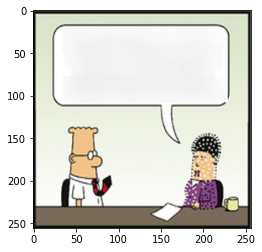

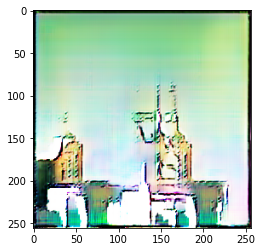

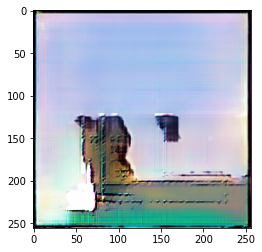

D Real: 0.03550764173269272
D Fake: 0.03243108466267586
G All:: 5.756099700927734
D Real: 0.022648554295301437
D Fake: 0.030645113438367844
G All:: 5.834490776062012
D Real: 0.03964218124747276
D Fake: 0.03157198429107666
G All:: 4.704097747802734
D Real: 0.02480127476155758
D Fake: 0.043681204319000244
G All:: 4.735947132110596
D Real: 0.030333377420902252
D Fake: 0.037146955728530884
G All:: 5.1259660720825195
D Real: 0.03391715884208679
D Fake: 0.032412074506282806
G All:: 5.538515567779541
D Real: 0.0384342297911644
D Fake: 0.04056968539953232
G All:: 6.098151683807373
D Real: 0.03217872232198715
D Fake: 0.11847444623708725
G All:: 3.674013614654541
D Real: 0.03780077397823334
D Fake: 0.04398269206285477
G All:: 3.5655314922332764




Round 69000:
D Real: 0.03465401753783226
D Fake: 0.027829887345433235
G All:: 5.501911163330078


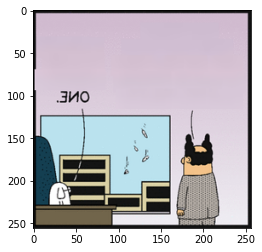

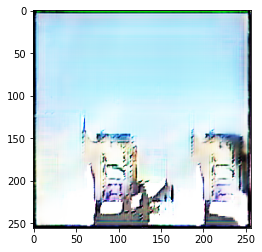

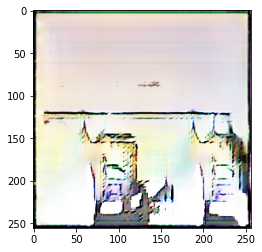

D Real: 0.03187616169452667
D Fake: 0.055331043899059296
G All:: 5.384057521820068
D Real: 0.034804195165634155
D Fake: 0.03983189910650253
G All:: 6.119807243347168
D Real: 0.06465305387973785
D Fake: 0.04523319751024246
G All:: 5.182216644287109
D Real: 0.028554782271385193
D Fake: 0.03652995079755783
G All:: 6.585341453552246
D Real: 0.06036099046468735
D Fake: 0.042689625173807144
G All:: 5.7664079666137695
D Real: 0.02688172087073326
D Fake: 0.03824760764837265
G All:: 6.378499984741211
D Real: 0.03720720112323761
D Fake: 0.03502901643514633
G All:: 4.597627639770508
D Real: 0.0447978749871254
D Fake: 0.0378509983420372
G All:: 7.048073768615723
D Real: 0.03369571268558502
D Fake: 0.03973494842648506
G All:: 5.5072245597839355




Round 70000:
D Real: 0.03643296658992767
D Fake: 0.03913475573062897
G All:: 2.930173873901367


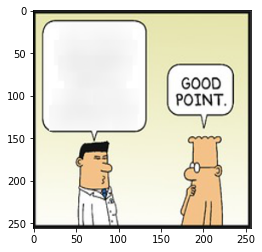

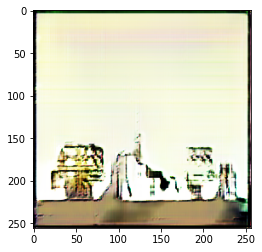

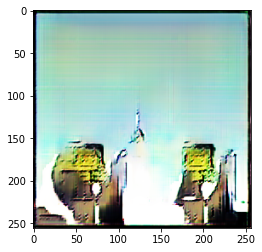

D Real: 0.033343903720378876
D Fake: 0.0270700640976429
G All:: 6.639604568481445
D Real: 0.03605948016047478
D Fake: 0.03873041272163391
G All:: 5.549839019775391
D Real: 0.0385272316634655
D Fake: 0.03995256870985031
G All:: 5.113239765167236
D Real: 0.03380635380744934
D Fake: 0.03572854399681091
G All:: 5.796493053436279
D Real: 0.053333744406700134
D Fake: 0.040074776858091354
G All:: 6.223623752593994
D Real: 0.02836548164486885
D Fake: 0.04435497149825096
G All:: 4.6765923500061035
D Real: 0.03678398206830025
D Fake: 0.03698421269655228
G All:: 5.598731994628906
D Real: 0.03932266682386398
D Fake: 0.03367089480161667
G All:: 6.074959754943848
D Real: 0.04574116691946983
D Fake: 0.023206446319818497
G All:: 7.40086030960083




Round 71000:
D Real: 0.048992566764354706
D Fake: 0.055511634796857834
G All:: 8.005720138549805


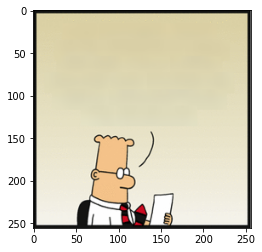

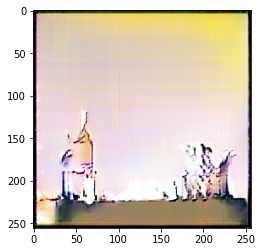

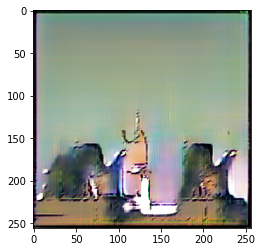

D Real: 0.046754851937294006
D Fake: 0.03221894055604935
G All:: 5.971963405609131
D Real: 0.03730333596467972
D Fake: 0.041772693395614624
G All:: 6.215292453765869
D Real: 0.03490886837244034
D Fake: 0.022503692656755447
G All:: 5.698793411254883
D Real: 0.03543715178966522
D Fake: 0.03125191479921341
G All:: 5.783452033996582
D Real: 0.04154571518301964
D Fake: 0.02999582514166832
G All:: 4.664855003356934
D Real: 0.033772122114896774
D Fake: 0.043933965265750885
G All:: 5.061004638671875
D Real: 0.05067073926329613
D Fake: 0.028338121250271797
G All:: 4.51284122467041
D Real: 0.03220731019973755
D Fake: 0.0345996730029583
G All:: 5.898906230926514
D Real: 0.03713376075029373
D Fake: 0.040465377271175385
G All:: 4.898615837097168




Round 72000:
D Real: 0.03466929495334625
D Fake: 0.023350857198238373
G All:: 5.828863143920898


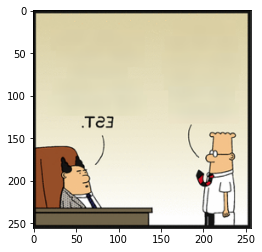

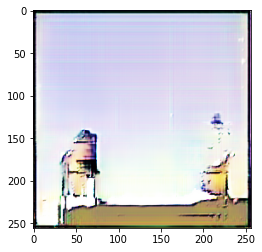

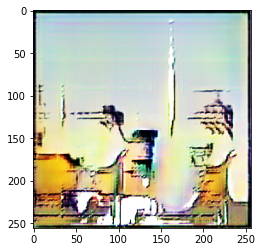

D Real: 0.033702053129673004
D Fake: 0.03549126535654068
G All:: 6.820469856262207
D Real: 0.03277890011668205
D Fake: 0.031554192304611206
G All:: 3.388552665710449
D Real: 0.02689371630549431
D Fake: 0.028419384732842445
G All:: 6.074701309204102
D Real: 0.04946541786193848
D Fake: 0.039879120886325836
G All:: 6.190212726593018
D Real: 0.0388512909412384
D Fake: 0.05418466776609421
G All:: 7.261940002441406
D Real: 0.04834558814764023
D Fake: 0.04188639670610428
G All:: 3.6123569011688232
D Real: 0.030615326017141342
D Fake: 0.0833074077963829
G All:: 4.669527053833008
D Real: 0.038164302706718445
D Fake: 0.04079218581318855
G All:: 6.811739921569824
D Real: 0.047811150550842285
D Fake: 0.03846563398838043
G All:: 6.710536479949951




Round 73000:
D Real: 0.034382544457912445
D Fake: 0.04925129562616348
G All:: 5.601527214050293


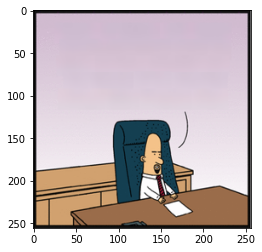

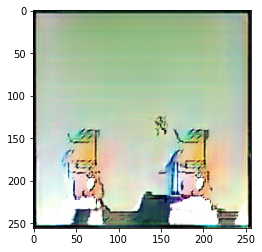

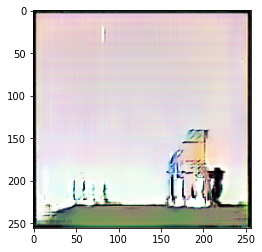

D Real: 0.030148012563586235
D Fake: 0.040528956800699234
G All:: 5.272172927856445
D Real: 0.03241373598575592
D Fake: 0.03547511249780655
G All:: 5.909302711486816
D Real: 0.03474580496549606
D Fake: 0.030252238735556602
G All:: 6.03883171081543
D Real: 0.030268192291259766
D Fake: 0.03158363699913025
G All:: 5.748075008392334
D Real: 0.07873285561800003
D Fake: 0.0354156419634819
G All:: 5.074726104736328
D Real: 0.024838585406541824
D Fake: 0.033923789858818054
G All:: 5.931118011474609
D Real: 0.04048796743154526
D Fake: 0.04524011164903641
G All:: 4.671586036682129
D Real: 0.04045180231332779
D Fake: 0.02642403170466423
G All:: 6.7462053298950195
D Real: 0.03571757301688194
D Fake: 0.028145819902420044
G All:: 6.682927131652832




Round 74000:
D Real: 0.026844725012779236
D Fake: 0.02691822126507759
G All:: 5.505056381225586


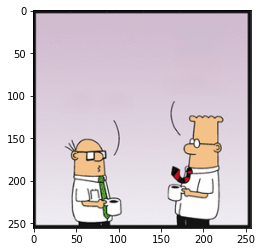

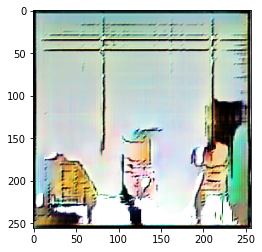

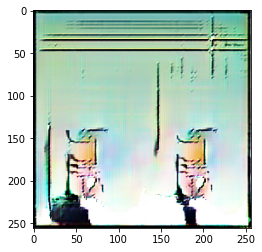

D Real: 0.028993286192417145
D Fake: 0.02272290363907814
G All:: 7.149802207946777
D Real: 0.03125983104109764
D Fake: 0.03464324027299881
G All:: 6.146712303161621
D Real: 0.03246606886386871
D Fake: 0.033342208713293076
G All:: 4.862818717956543
D Real: 0.047852449119091034
D Fake: 0.07607162743806839
G All:: 4.2494120597839355
D Real: 0.040444083511829376
D Fake: 0.04193376749753952
G All:: 4.804722785949707
D Real: 0.04295353591442108
D Fake: 0.06330510973930359
G All:: 2.640331745147705
D Real: 0.04273489862680435
D Fake: 0.0411863848567009
G All:: 6.286593437194824
D Real: 0.030592912808060646
D Fake: 0.04893947020173073
G All:: 6.649774551391602
D Real: 0.026689298450946808
D Fake: 0.028779979795217514
G All:: 5.918590545654297




Round 75000:
D Real: 0.03697624057531357
D Fake: 0.054235994815826416
G All:: 4.856978893280029


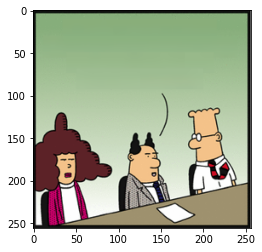

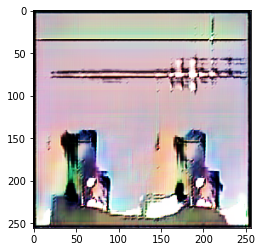

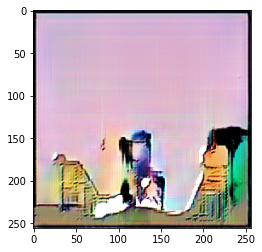

D Real: 0.03364124149084091
D Fake: 0.041874535381793976
G All:: 6.280139923095703
D Real: 0.033402424305677414
D Fake: 0.035229723900556564
G All:: 5.3585004806518555
D Real: 0.027598120272159576
D Fake: 0.03397517278790474
G All:: 6.699951648712158
D Real: 0.02039153128862381
D Fake: 0.03186068683862686
G All:: 5.703296661376953
D Real: 0.03743620589375496
D Fake: 0.03857187554240227
G All:: 5.895971298217773
D Real: 0.02750120311975479
D Fake: 0.02595532312989235
G All:: 5.7300519943237305
D Real: 0.03026287443935871
D Fake: 0.04826726019382477
G All:: 6.435450077056885
D Real: 0.03742864727973938
D Fake: 0.04978682100772858
G All:: 4.609338760375977
D Real: 0.05471190810203552
D Fake: 0.053207047283649445
G All:: 5.9810028076171875




Round 76000:
D Real: 0.04066692292690277
D Fake: 0.02465786784887314
G All:: 7.166879653930664


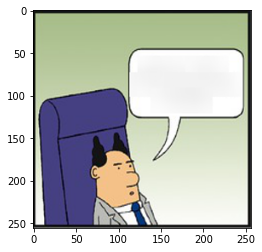

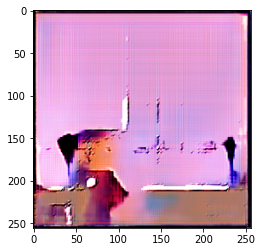

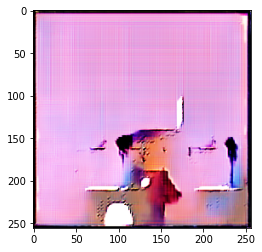

D Real: 0.03950210288167
D Fake: 0.042853839695453644
G All:: 7.172970294952393
D Real: 0.03245798125863075
D Fake: 0.017415978014469147
G All:: 5.605800628662109
D Real: 0.04512454569339752
D Fake: 0.05010884255170822
G All:: 4.125517845153809
D Real: 0.033610858023166656
D Fake: 0.032390348613262177
G All:: 3.969280242919922
D Real: 0.03451313078403473
D Fake: 0.020225416868925095
G All:: 6.699054718017578
D Real: 0.039260562509298325
D Fake: 0.03644320368766785
G All:: 5.918663024902344
D Real: 0.02455516904592514
D Fake: 0.0460067018866539
G All:: 6.377353668212891
D Real: 0.039876338094472885
D Fake: 0.026156999170780182
G All:: 6.309772491455078
D Real: 0.0373649001121521
D Fake: 0.03387368470430374
G All:: 6.4158935546875




Round 77000:
D Real: 0.03433739393949509
D Fake: 0.03985016047954559
G All:: 5.044339656829834


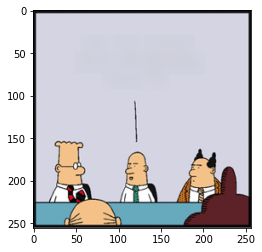

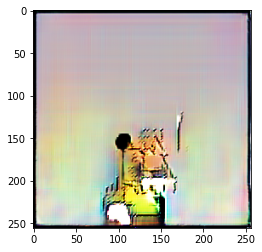

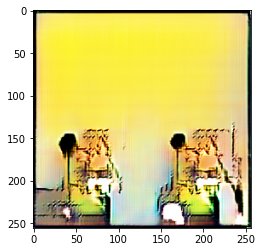

D Real: 0.03671228885650635
D Fake: 0.034664466977119446
G All:: 6.457666397094727
D Real: 0.028364351019263268
D Fake: 0.038602884858846664
G All:: 5.617006301879883
D Real: 0.03498817980289459
D Fake: 0.02400817722082138
G All:: 6.6355977058410645
D Real: 0.024179115891456604
D Fake: 0.047389112412929535
G All:: 7.069660186767578
D Real: 0.03870648518204689
D Fake: 0.0365951769053936
G All:: 7.615406036376953
D Real: 0.02239624410867691
D Fake: 0.047261111438274384
G All:: 6.328392028808594
D Real: 0.03254777193069458
D Fake: 0.02880270592868328
G All:: 4.309341907501221
D Real: 0.03851282596588135
D Fake: 0.047415077686309814
G All:: 9.067188262939453
D Real: 0.03450384736061096
D Fake: 0.03792719542980194
G All:: 5.077171325683594




Round 78000:
D Real: 0.03980477899312973
D Fake: 0.02917950414121151
G All:: 6.186601638793945


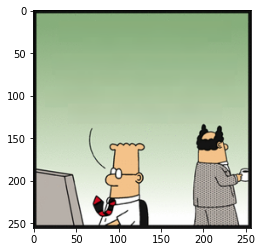

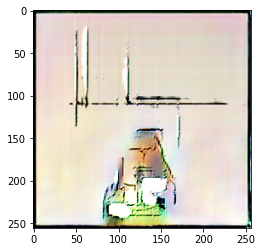

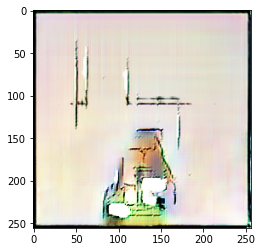

D Real: 0.02760431170463562
D Fake: 0.029029862955212593
G All:: 5.230409145355225
D Real: 0.025455104187130928
D Fake: 0.03723514825105667
G All:: 4.908416271209717
D Real: 0.041543155908584595
D Fake: 0.033567946404218674
G All:: 5.540810585021973
D Real: 0.030134230852127075
D Fake: 0.051215752959251404
G All:: 5.48282527923584
D Real: 0.03302663564682007
D Fake: 0.031072989106178284
G All:: 5.198677062988281
D Real: 0.04092928394675255
D Fake: 0.03881355747580528
G All:: 5.484379768371582
D Real: 0.03495538979768753
D Fake: 0.03878975659608841
G All:: 6.457427501678467
D Real: 0.04004809632897377
D Fake: 0.04297304525971413
G All:: 6.031216621398926
D Real: 0.026273448020219803
D Fake: 0.02179243415594101
G All:: 6.765665054321289




Round 79000:
D Real: 0.04009994864463806
D Fake: 0.028961360454559326
G All:: 3.580634117126465


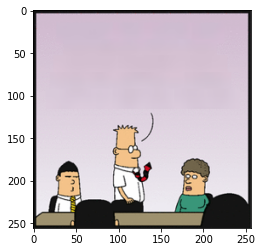

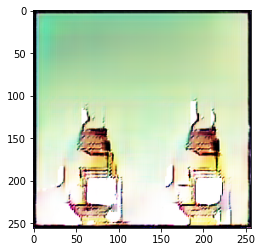

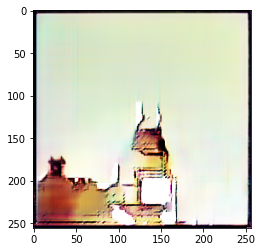

D Real: 0.02597651444375515
D Fake: 0.04482169449329376
G All:: 7.8179473876953125
D Real: 0.024987872689962387
D Fake: 0.036330509930849075
G All:: 5.957206726074219
D Real: 0.03266412019729614
D Fake: 0.043623942881822586
G All:: 5.151393413543701
D Real: 0.020543500781059265
D Fake: 0.02568572200834751
G All:: 7.002391815185547
D Real: 0.041101545095443726
D Fake: 0.02426924929022789
G All:: 6.054782867431641
D Real: 0.02678218111395836
D Fake: 0.03497935086488724
G All:: 5.941885948181152
D Real: 0.02980278618633747
D Fake: 0.029849320650100708
G All:: 6.125992774963379
D Real: 0.029312681406736374
D Fake: 0.03806225582957268
G All:: 5.6698079109191895
D Real: 0.04584570229053497
D Fake: 0.04971713572740555
G All:: 10.030795097351074




Round 80000:
D Real: 0.0390804260969162
D Fake: 0.036616481840610504
G All:: 5.035124778747559


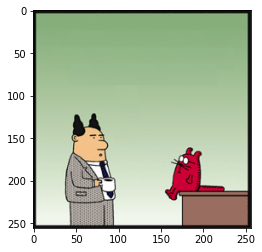

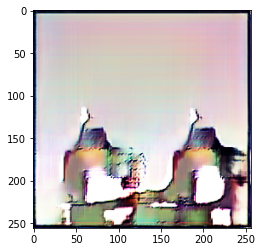

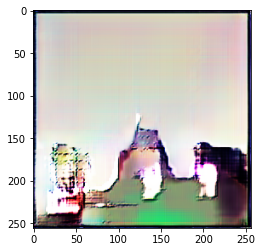

D Real: 0.03060148097574711
D Fake: 0.03237902373075485
G All:: 5.34459924697876
D Real: 0.02573748305439949
D Fake: 0.04062638059258461
G All:: 5.482675075531006
D Real: 0.028212478384375572
D Fake: 0.04087042436003685
G All:: 5.7409515380859375
D Real: 0.03290221467614174
D Fake: 0.03631358593702316
G All:: 5.292001724243164
D Real: 0.026852216571569443
D Fake: 0.04972028732299805
G All:: 5.820816993713379
D Real: 0.02906712517142296
D Fake: 0.025370530784130096
G All:: 4.044495582580566
D Real: 0.04757242277264595
D Fake: 0.03903679922223091
G All:: 7.069294452667236
D Real: 0.0342608205974102
D Fake: 0.05258392542600632
G All:: 5.2823944091796875
D Real: 0.04611450433731079
D Fake: 0.03746003657579422
G All:: 5.31373405456543




Round 81000:
D Real: 0.03564649820327759
D Fake: 0.04019436240196228
G All:: 6.235071182250977


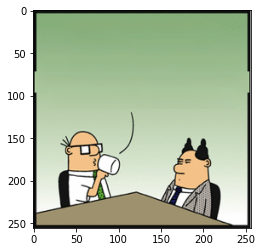

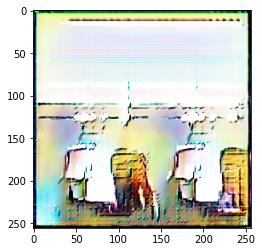

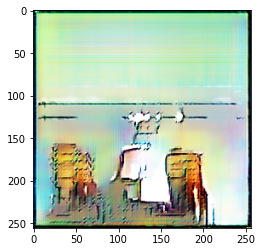

D Real: 0.031277164816856384
D Fake: 0.028853194788098335
G All:: 6.166707992553711
D Real: 0.02538490481674671
D Fake: 0.02993391454219818
G All:: 5.898065567016602
D Real: 0.03913047909736633
D Fake: 0.028751589357852936
G All:: 6.993358135223389
D Real: 0.046791985630989075
D Fake: 0.03674127534031868
G All:: 5.492340564727783
D Real: 0.027330530807375908
D Fake: 0.049920059740543365
G All:: 5.054141044616699
D Real: 0.040139175951480865
D Fake: 0.025812899693846703
G All:: 6.721026420593262
D Real: 0.032641224563121796
D Fake: 0.03493814170360565
G All:: 7.807271480560303
D Real: 0.044016994535923004
D Fake: 0.03416094556450844
G All:: 5.107975006103516
D Real: 0.03581122308969498
D Fake: 0.03621279075741768
G All:: 5.97344970703125




Round 82000:
D Real: 0.025744933634996414
D Fake: 0.02743518352508545
G All:: 5.811707019805908


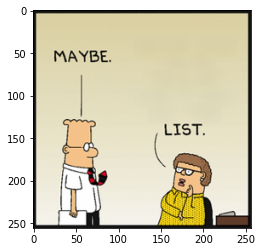

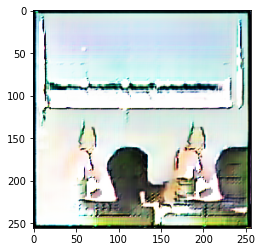

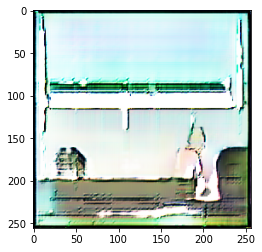

D Real: 0.03474592790007591
D Fake: 0.03542683273553848
G All:: 7.030704498291016
D Real: 0.01733209379017353
D Fake: 0.03784799575805664
G All:: 6.105696678161621
D Real: 0.03809604421257973
D Fake: 0.03238316625356674
G All:: 5.753612518310547
D Real: 0.027125753462314606
D Fake: 0.03407244011759758
G All:: 5.614414215087891
D Real: 0.03339538350701332
D Fake: 0.03170540928840637
G All:: 5.264815330505371
D Real: 0.03846290707588196
D Fake: 0.03584671393036842
G All:: 6.083366870880127
D Real: 0.04297509044408798
D Fake: 0.04179944843053818
G All:: 7.161835670471191
D Real: 0.04148063436150551
D Fake: 0.046693939715623856
G All:: 6.491308689117432
D Real: 0.045501358807086945
D Fake: 0.027195241302251816
G All:: 7.889141082763672




Round 83000:
D Real: 0.033629558980464935
D Fake: 0.03919375687837601
G All:: 5.940315246582031


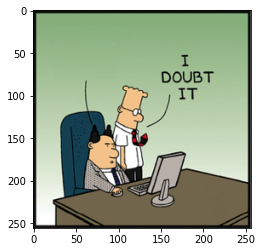

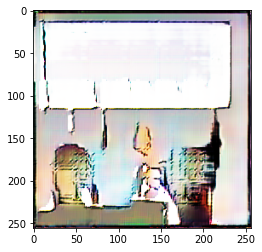

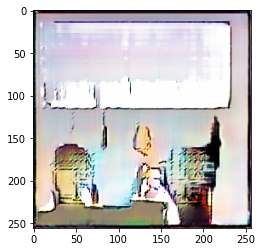

D Real: 0.03009435534477234
D Fake: 0.038989681750535965
G All:: 5.976986885070801
D Real: 0.03620237857103348
D Fake: 0.039505019783973694
G All:: 6.353389739990234
D Real: 0.05056171119213104
D Fake: 0.039542559534311295
G All:: 5.829946994781494
D Real: 0.02175752818584442
D Fake: 0.046196456998586655
G All:: 7.4728102684021
D Real: 0.04984293878078461
D Fake: 0.0416281633079052
G All:: 6.404580593109131
D Real: 0.030673012137413025
D Fake: 0.040391962975263596
G All:: 6.251590728759766
D Real: 0.03548002615571022
D Fake: 0.05275804549455643
G All:: 6.091524124145508
D Real: 0.03836939483880997
D Fake: 0.03128514438867569
G All:: 5.225693702697754
D Real: 0.039319805800914764
D Fake: 0.07367531955242157
G All:: 4.90035343170166




Round 84000:
D Real: 0.03329315781593323
D Fake: 0.037864044308662415
G All:: 5.109540939331055


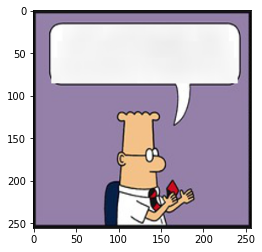

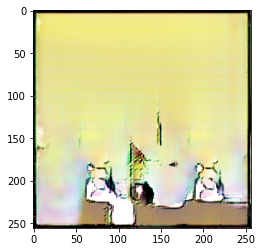

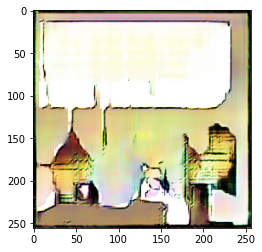

D Real: 0.042563796043395996
D Fake: 0.036445699632167816
G All:: 5.367053985595703
D Real: 0.03786459565162659
D Fake: 0.036548368632793427
G All:: 5.692047119140625
D Real: 0.026344597339630127
D Fake: 0.06136251240968704
G All:: 5.005059242248535
D Real: 0.061715174466371536
D Fake: 0.03238852322101593
G All:: 6.896653652191162
D Real: 0.035621389746665955
D Fake: 0.04439861699938774
G All:: 6.105417251586914
D Real: 0.04042001813650131
D Fake: 0.037579186260700226
G All:: 6.2949676513671875
D Real: 0.0329417809844017
D Fake: 0.03868330270051956
G All:: 6.113444805145264
D Real: 0.032543428242206573
D Fake: 0.04432015120983124
G All:: 7.37139368057251
D Real: 0.0389900840818882
D Fake: 0.047385700047016144
G All:: 8.862846374511719




Round 85000:
D Real: 0.02940678410232067
D Fake: 0.026188461109995842
G All:: 6.00974702835083


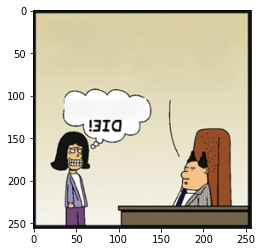

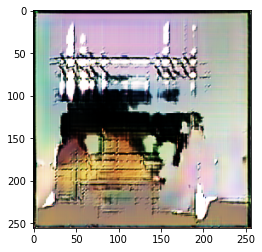

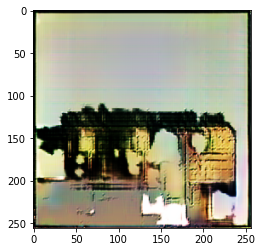

D Real: 0.03884867578744888
D Fake: 0.032876692712306976
G All:: 6.384626388549805
D Real: 0.03351786360144615
D Fake: 0.042065203189849854
G All:: 5.981705665588379
D Real: 0.03854489326477051
D Fake: 0.04152476415038109
G All:: 4.968655109405518
D Real: 0.03205953538417816
D Fake: 0.03224832937121391
G All:: 5.7645583152771
D Real: 0.029279809445142746
D Fake: 0.03538081794977188
G All:: 6.623068809509277
D Real: 0.042697012424468994
D Fake: 0.03199813514947891
G All:: 5.447164535522461
D Real: 0.036938488483428955
D Fake: 0.039999112486839294
G All:: 5.9322614669799805
D Real: 0.035609401762485504
D Fake: 0.03873344883322716
G All:: 7.044825553894043
D Real: 0.03152770176529884
D Fake: 0.019508840516209602
G All:: 5.900699615478516




Round 86000:
D Real: 0.03206503018736839
D Fake: 0.04338245838880539
G All:: 5.2147722244262695


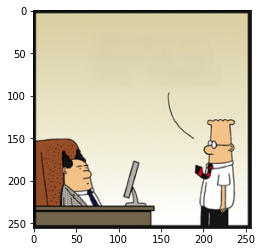

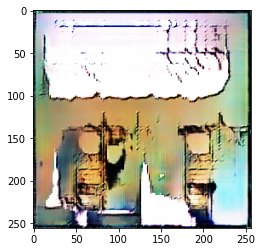

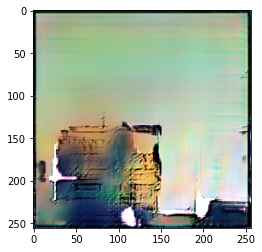

D Real: 0.03746610879898071
D Fake: 0.035940028727054596
G All:: 6.747862339019775
D Real: 0.025933783501386642
D Fake: 0.03659994527697563
G All:: 5.570194244384766
D Real: 0.03953881561756134
D Fake: 0.04760083183646202
G All:: 4.674619197845459
D Real: 0.10711807012557983
D Fake: 0.0517006441950798
G All:: 4.394867897033691
D Real: 0.033458810299634933
D Fake: 0.04960518330335617
G All:: 6.518515586853027
D Real: 0.03159830719232559
D Fake: 0.03694072738289833
G All:: 6.868637561798096
D Real: 0.03962278738617897
D Fake: 0.03651972860097885
G All:: 6.03792142868042
D Real: 0.027863197028636932
D Fake: 0.041067611426115036
G All:: 5.634723663330078
D Real: 0.035767458379268646
D Fake: 0.03379359841346741
G All:: 5.959613800048828




Round 87000:
D Real: 0.17850761115550995
D Fake: 0.03548162430524826
G All:: 6.986931800842285


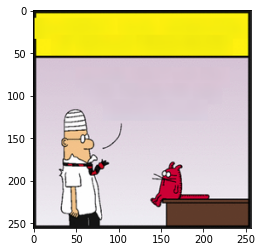

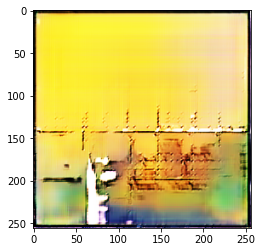

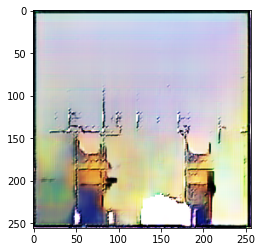

D Real: 0.036198779940605164
D Fake: 0.03680075705051422
G All:: 5.202276706695557
D Real: 0.035215429961681366
D Fake: 0.03763292357325554
G All:: 5.790231704711914
D Real: 0.03447774425148964
D Fake: 0.04389040917158127
G All:: 5.4473161697387695
D Real: 0.03790502995252609
D Fake: 0.03165377676486969
G All:: 6.101615905761719
D Real: 0.048423536121845245
D Fake: 0.04186104238033295
G All:: 5.9323410987854
D Real: 0.0649649053812027
D Fake: 0.03428114950656891
G All:: 6.429753303527832
D Real: 0.03966805338859558
D Fake: 0.034797199070453644
G All:: 5.483462810516357
D Real: 0.03850681334733963
D Fake: 0.031792573630809784
G All:: 5.901895046234131
D Real: 0.0453338697552681
D Fake: 0.04707849770784378
G All:: 4.947470664978027




Round 88000:
D Real: 0.036766551434993744
D Fake: 0.038211166858673096
G All:: 7.4115190505981445


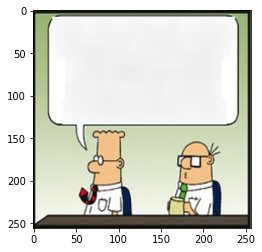

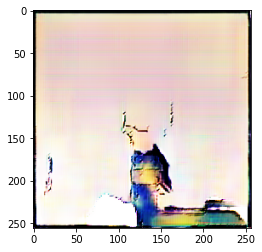

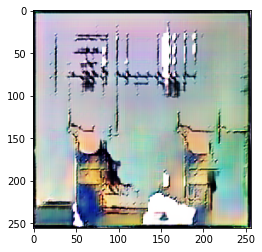

D Real: 0.051687516272068024
D Fake: 0.03175332397222519
G All:: 5.5174031257629395
D Real: 0.03175320476293564
D Fake: 0.03184521198272705
G All:: 5.105564594268799
D Real: 0.0423944890499115
D Fake: 0.03816141560673714
G All:: 9.44080924987793
D Real: 0.023441733792424202
D Fake: 0.03593534976243973
G All:: 5.9582109451293945
D Real: 0.027875268831849098
D Fake: 0.033742569386959076
G All:: 6.457719802856445
D Real: 0.023456741124391556
D Fake: 0.032496728003025055
G All:: 6.282764434814453
D Real: 0.03778286278247833
D Fake: 0.039293497800827026
G All:: 5.155579090118408
D Real: 0.03128991276025772
D Fake: 0.027220919728279114
G All:: 4.287334442138672
D Real: 0.03161337599158287
D Fake: 0.03548506647348404
G All:: 4.893959999084473




Round 89000:
D Real: 0.0275419931858778
D Fake: 0.04421629756689072
G All:: 6.10060977935791


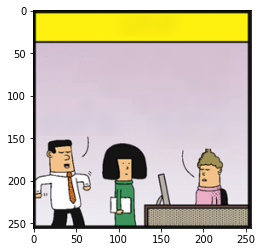

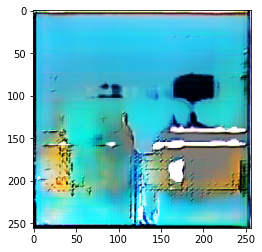

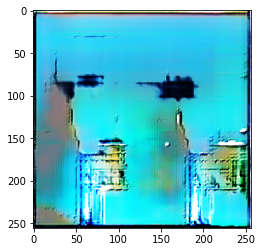

D Real: 0.03481820970773697
D Fake: 0.03857129439711571
G All:: 6.3386125564575195
D Real: 0.038132745772600174
D Fake: 0.037796277552843094
G All:: 6.328477382659912
D Real: 0.02605169080197811
D Fake: 0.023790515959262848
G All:: 5.505040645599365
D Real: 0.06455802917480469
D Fake: 0.035885561257600784
G All:: 6.749159812927246
D Real: 0.021885238587856293
D Fake: 0.041534632444381714
G All:: 7.168671607971191
D Real: 0.02987741492688656
D Fake: 0.03265013545751572
G All:: 5.684202194213867
D Real: 0.0402689054608345
D Fake: 0.04755473881959915
G All:: 6.612305641174316
D Real: 0.03265630453824997
D Fake: 0.060703955590724945
G All:: 4.115780353546143
D Real: 0.029041625559329987
D Fake: 0.03430064767599106
G All:: 5.432840347290039




Round 90000:
D Real: 0.038320910185575485
D Fake: 0.043117307126522064
G All:: 6.428184509277344


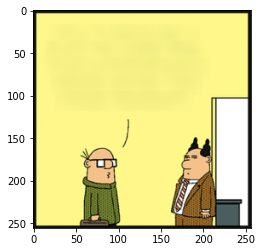

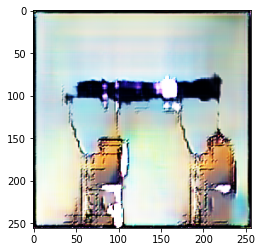

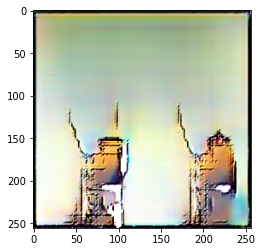

D Real: 0.05540315434336662
D Fake: 0.031699731945991516
G All:: 5.867927074432373
D Real: 0.030098656192421913
D Fake: 0.026666861027479172
G All:: 7.743870735168457
D Real: 0.03488744795322418
D Fake: 0.02287232130765915
G All:: 7.265865325927734
D Real: 0.02850005403161049
D Fake: 0.040757983922958374
G All:: 5.880782127380371
D Real: 0.054102689027786255
D Fake: 0.036838047206401825
G All:: 6.051812648773193
D Real: 0.024731766432523727
D Fake: 0.04713311418890953
G All:: 7.169112205505371
D Real: 0.03462402522563934
D Fake: 0.03894878178834915
G All:: 6.0177812576293945
D Real: 0.0368579663336277
D Fake: 0.03777544945478439
G All:: 6.078788757324219
D Real: 0.03187033534049988
D Fake: 0.03256693482398987
G All:: 6.411444664001465




Round 91000:
D Real: 0.01938973367214203
D Fake: 0.0318843349814415
G All:: 6.769706726074219


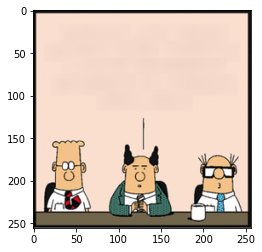

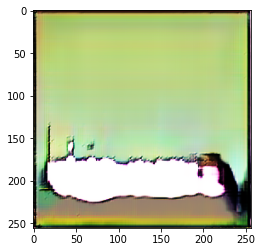

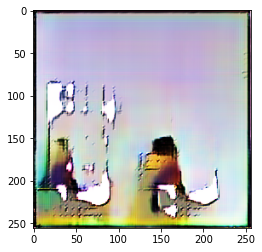

D Real: 0.030035877600312233
D Fake: 0.022060126066207886
G All:: 4.63532829284668
D Real: 0.033016636967659
D Fake: 0.042808759957551956
G All:: 5.6837358474731445
D Real: 0.032114043831825256
D Fake: 0.02288137748837471
G All:: 5.4092183113098145
D Real: 0.0317319817841053
D Fake: 0.035139959305524826
G All:: 5.079831123352051
D Real: 0.02811545878648758
D Fake: 0.0380694679915905
G All:: 5.301372528076172
D Real: 0.036792367696762085
D Fake: 0.02921076864004135
G All:: 5.882346153259277
D Real: 0.024724001064896584
D Fake: 0.03312797471880913
G All:: 6.158863544464111
D Real: 0.029623612761497498
D Fake: 0.03166273981332779
G All:: 5.381977558135986
D Real: 0.0393846221268177
D Fake: 0.029069576412439346
G All:: 5.749667167663574




Round 92000:
D Real: 0.043165452778339386
D Fake: 0.04258081316947937
G All:: 6.651732921600342


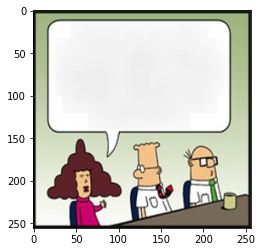

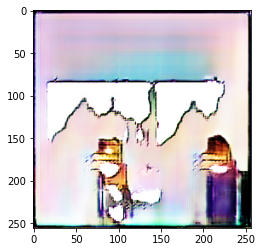

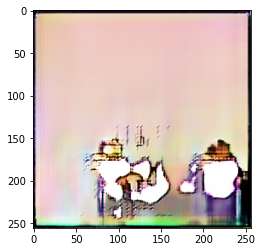

D Real: 0.03007790818810463
D Fake: 0.1261368840932846
G All:: 5.356273651123047
D Real: 0.03183206170797348
D Fake: 0.04074285179376602
G All:: 5.5596394538879395
D Real: 0.038050852715969086
D Fake: 0.022782793268561363
G All:: 5.9485697746276855
D Real: 0.02147771790623665
D Fake: 0.02609921246767044
G All:: 7.2373433113098145
D Real: 0.02398545667529106
D Fake: 0.031820058822631836
G All:: 5.970446586608887
D Real: 0.033270351588726044
D Fake: 0.027708718553185463
G All:: 6.106026649475098
D Real: 0.035892829298973083
D Fake: 0.041918233036994934
G All:: 5.284445762634277
D Real: 0.04797317087650299
D Fake: 0.03888901323080063
G All:: 6.891229629516602
D Real: 0.035143911838531494
D Fake: 0.030551480129361153
G All:: 5.426198959350586




Round 93000:
D Real: 0.042730286717414856
D Fake: 0.02854926511645317
G All:: 5.533565521240234


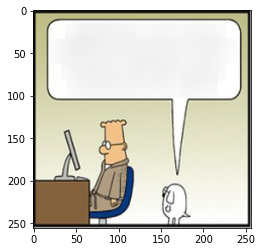

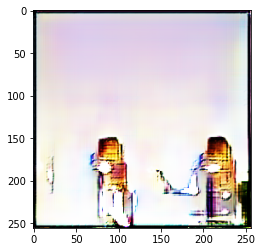

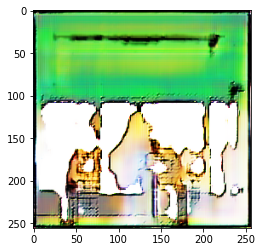

D Real: 0.0313003808259964
D Fake: 0.033597432076931
G All:: 5.006827354431152
D Real: 0.04105699807405472
D Fake: 0.04179123789072037
G All:: 5.516429901123047
D Real: 0.028846517205238342
D Fake: 0.048002779483795166
G All:: 6.21519660949707
D Real: 0.02582215517759323
D Fake: 0.02595679648220539
G All:: 5.778376579284668
D Real: 0.03303349018096924
D Fake: 0.029225043952465057
G All:: 5.310861587524414
D Real: 0.03314487636089325
D Fake: 0.04327639192342758
G All:: 7.007482528686523
D Real: 0.031068317592144012
D Fake: 0.024542316794395447
G All:: 5.621365547180176
D Real: 0.026378583163022995
D Fake: 0.04495682567358017
G All:: 6.326559066772461
D Real: 0.028635235503315926
D Fake: 0.016942214220762253
G All:: 4.979062557220459




Round 94000:
D Real: 0.036127932369709015
D Fake: 0.02681921049952507
G All:: 6.318552017211914


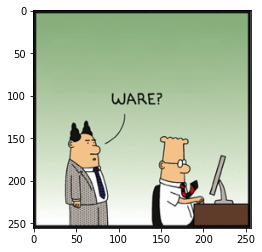

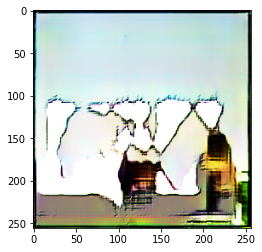

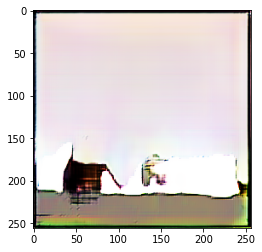

D Real: 0.033432431519031525
D Fake: 0.033719826489686966
G All:: 6.762301445007324
D Real: 0.036871299147605896
D Fake: 0.04344252869486809
G All:: 7.1257219314575195
D Real: 0.03578846901655197
D Fake: 0.05177506059408188
G All:: 6.105796813964844
D Real: 0.03881213068962097
D Fake: 0.040240611881017685
G All:: 5.153947353363037
D Real: 0.04893603175878525
D Fake: 0.033728282898664474
G All:: 5.617333889007568
D Real: 0.036764178425073624
D Fake: 0.03096587210893631
G All:: 5.553778171539307
D Real: 0.03543216362595558
D Fake: 0.040752112865448
G All:: 5.083838939666748
D Real: 0.024294152855873108
D Fake: 0.03565261885523796
G All:: 6.218968868255615
D Real: 0.039401452988386154
D Fake: 0.03009755164384842
G All:: 6.006277561187744




Round 95000:
D Real: 0.02536119893193245
D Fake: 0.050649821758270264
G All:: 5.687150478363037


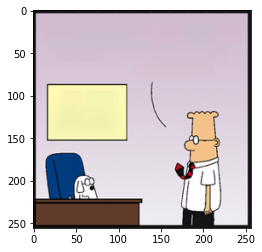

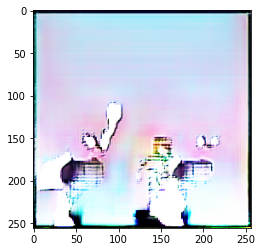

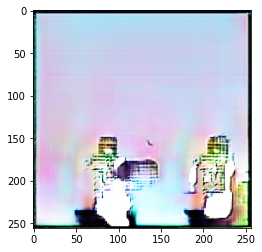

D Real: 0.03636990860104561
D Fake: 0.02910587191581726
G All:: 5.122358322143555
D Real: 0.030749710276722908
D Fake: 0.0326172336935997
G All:: 5.8824357986450195
D Real: 0.03285723924636841
D Fake: 0.029362592846155167
G All:: 6.638254165649414
D Real: 0.023931892588734627
D Fake: 0.04772481322288513
G All:: 6.806980609893799
D Real: 0.03233350068330765
D Fake: 0.02338269352912903
G All:: 5.843155384063721
D Real: 0.039528798311948776
D Fake: 0.054825086146593094
G All:: 5.903754711151123
D Real: 0.03344612568616867
D Fake: 0.04253601282835007
G All:: 5.482298374176025
D Real: 0.024908604100346565
D Fake: 0.029484761878848076
G All:: 5.96383810043335
D Real: 0.037044111639261246
D Fake: 0.03799387812614441
G All:: 6.225109100341797




Round 96000:
D Real: 0.03320138156414032
D Fake: 0.03380468860268593
G All:: 5.499801158905029


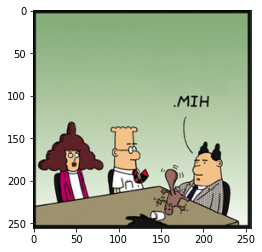

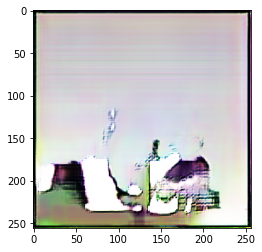

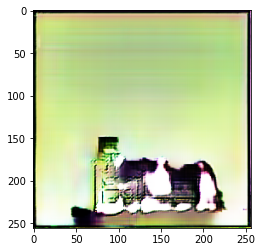

D Real: 0.02625291794538498
D Fake: 0.04239576309919357
G All:: 5.574403285980225
D Real: 0.029334941878914833
D Fake: 0.03798351436853409
G All:: 5.913695335388184
D Real: 0.04478101432323456
D Fake: 0.036836519837379456
G All:: 4.967500686645508
D Real: 0.032681118696928024
D Fake: 0.025391103699803352
G All:: 5.6818037033081055
D Real: 0.033565741032361984
D Fake: 0.038981348276138306
G All:: 5.776658058166504
D Real: 0.042620472609996796
D Fake: 0.02770274132490158
G All:: 5.953547477722168
D Real: 0.02132096141576767
D Fake: 0.045765019953250885
G All:: 5.433194160461426
D Real: 0.043808966875076294
D Fake: 0.03678886592388153
G All:: 5.356645107269287
D Real: 0.031082188710570335
D Fake: 0.025170769542455673
G All:: 5.114009380340576




Round 97000:
D Real: 0.0327775776386261
D Fake: 0.030055321753025055
G All:: 5.825798988342285


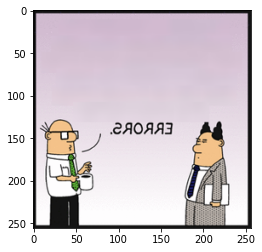

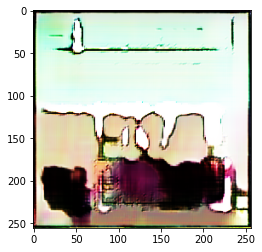

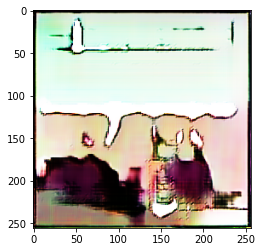

D Real: 0.03968013823032379
D Fake: 0.03813351318240166
G All:: 5.848649978637695
D Real: 0.04064014181494713
D Fake: 0.03242218866944313
G All:: 6.3892316818237305
D Real: 0.04332554712891579
D Fake: 0.0181814506649971
G All:: 5.88886022567749
D Real: 0.024500573053956032
D Fake: 0.03425874561071396
G All:: 5.094191074371338
D Real: 0.042378995567560196
D Fake: 0.03430617228150368
G All:: 5.8640642166137695
D Real: 0.04281970113515854
D Fake: 0.03368942812085152
G All:: 5.533064842224121
D Real: 0.031485415995121
D Fake: 0.03205512464046478
G All:: 6.377687454223633
D Real: 0.03351901099085808
D Fake: 0.03996707499027252
G All:: 5.675610065460205
D Real: 0.025736825540661812
D Fake: 0.03134184330701828
G All:: 6.469633102416992




Round 98000:
D Real: 0.0378241091966629
D Fake: 0.04020322114229202
G All:: 6.189099311828613


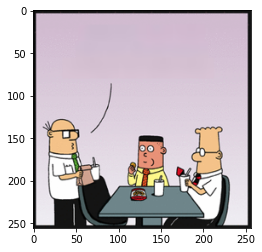

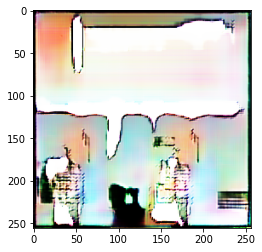

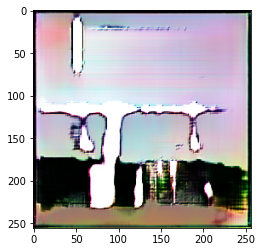

D Real: 0.04515288770198822
D Fake: 0.022834300994873047
G All:: 4.908232688903809
D Real: 0.03324803709983826
D Fake: 0.03403677046298981
G All:: 6.006865501403809
D Real: 0.028542635962367058
D Fake: 0.03808649629354477
G All:: 6.337109088897705
D Real: 0.04134494066238403
D Fake: 0.027827389538288116
G All:: 5.138090133666992
D Real: 0.029297705739736557
D Fake: 0.039761029183864594
G All:: 5.650054931640625
D Real: 0.031305015087127686
D Fake: 0.03470592573285103
G All:: 4.99167537689209
D Real: 0.02547917515039444
D Fake: 0.03509049862623215
G All:: 6.795985221862793
D Real: 0.041472624987363815
D Fake: 0.038850899785757065
G All:: 5.159130096435547
D Real: 0.0346943698823452
D Fake: 0.03409183770418167
G All:: 7.528125762939453




Round 99000:
D Real: 0.03134480118751526
D Fake: 0.027317039668560028
G All:: 6.214686393737793


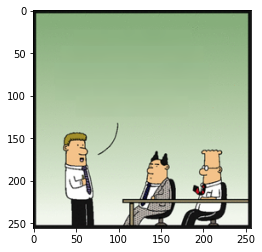

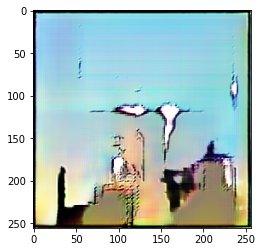

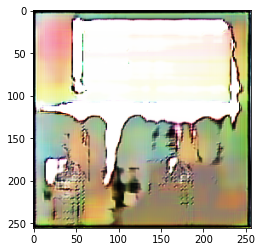

D Real: 0.03205282241106033
D Fake: 0.0246872641146183
G All:: 6.197897911071777
D Real: 0.028585342690348625
D Fake: 0.038172170519828796
G All:: 4.890262603759766
D Real: 0.04371604323387146
D Fake: 0.024957433342933655
G All:: 5.490528583526611
D Real: 0.038496144115924835
D Fake: 0.03858766704797745
G All:: 5.354265213012695
D Real: 0.02162940427660942
D Fake: 0.030571766197681427
G All:: 4.9103803634643555
D Real: 0.03006698749959469
D Fake: 0.040053464472293854
G All:: 6.493098258972168
D Real: 0.021381180733442307
D Fake: 0.022704705595970154
G All:: 6.059904098510742
D Real: 0.02879989892244339
D Fake: 0.0354953296482563
G All:: 6.218524932861328
D Real: 0.03657819330692291
D Fake: 0.03098512440919876
G All:: 6.0321760177612305




Round 100000:
D Real: 0.034558169543743134
D Fake: 0.03767380118370056
G All:: 5.279807090759277


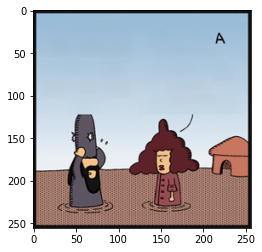

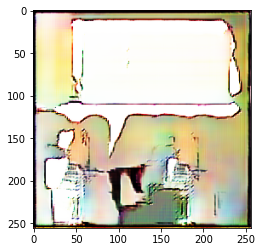

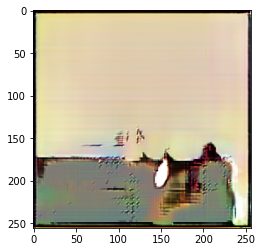

D Real: 0.017460785806179047
D Fake: 0.02832593210041523
G All:: 5.617873191833496


In [ ]:
model = Model_GAN()

model.GAN.steps = 51234
model.load(51)

print("We're off! See you in a while!")

while(model.GAN.steps < 500000):
    
    # print("\n\n\n\nRound " + str(model.GAN.steps) + ":")
    model.train()
    
    if model.GAN.steps % 1000 == 0:
        print("\n\n\n\nRound " + str(model.GAN.steps) + ":")
        model.eval2(int(model.GAN.steps / 1000))

We're off! See you in a while!
Epoch: 0
D Real: 0.15838410574228923
D Fake: 0.12181104826724695
G All:: 4.183504998268566


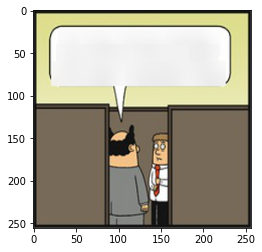

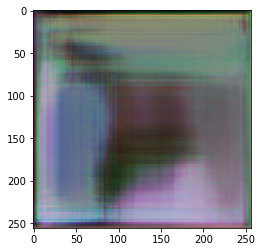

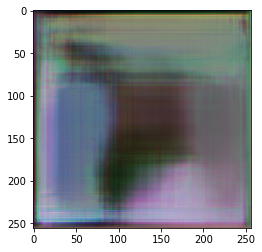

Epoch: 1
D Real: 0.0786475457497694
D Fake: 0.049413236708279684
G All:: 5.654629743888403


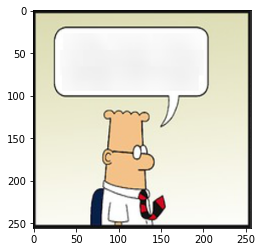

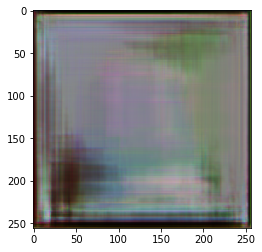

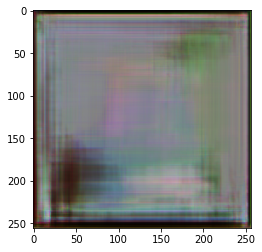

Epoch: 2
D Real: 0.08393365284914754
D Fake: 0.061298686550209744
G All:: 5.510549898346958


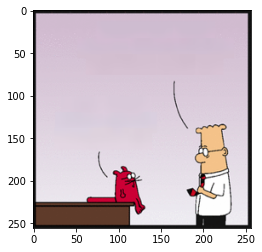

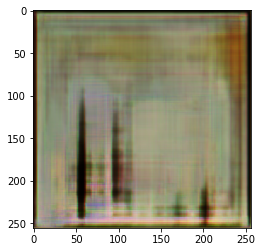

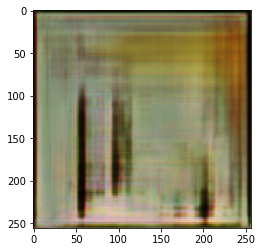

Epoch: 3
D Real: 0.10494485924520143
D Fake: 0.08298950702055821
G All:: 5.539809883263883


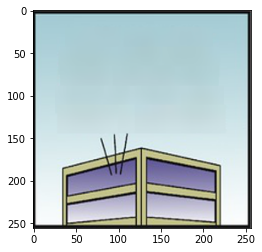

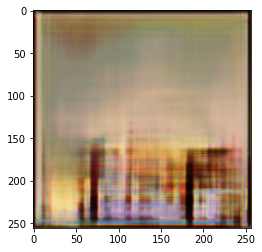

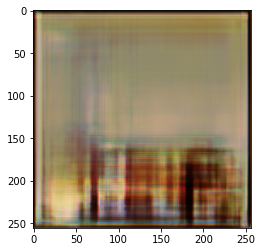

Epoch: 4
D Real: 0.09253964121437239
D Fake: 0.0735430694882878
G All:: 5.923953072119257


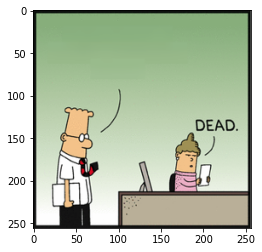

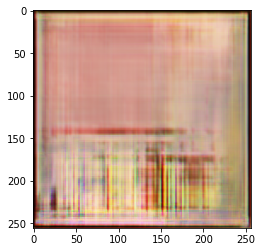

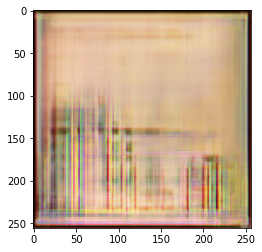

Epoch: 5
D Real: 0.09391428492573911
D Fake: 0.07437545291508324
G All:: 5.452114700855693


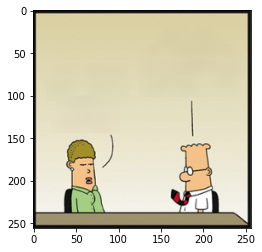

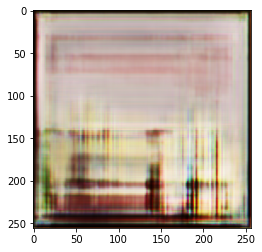

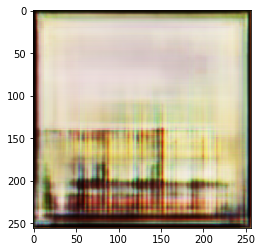

Epoch: 6
D Real: 0.08014431312836005
D Fake: 0.06877511755306961
G All:: 6.4295948124928755


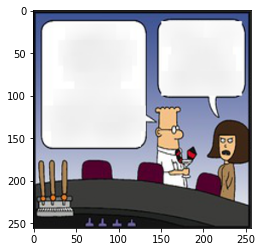

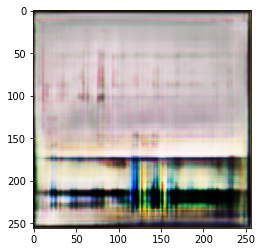

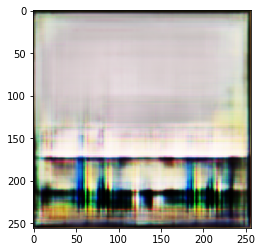

Epoch: 7
D Real: 0.07545861388955798
D Fake: 0.06082527289485059
G All:: 5.975757279877879


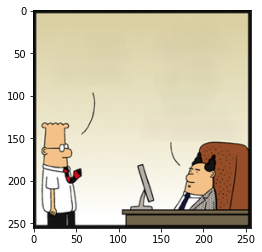

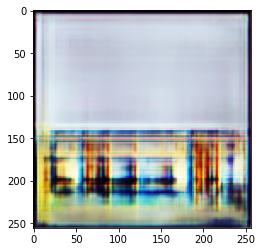

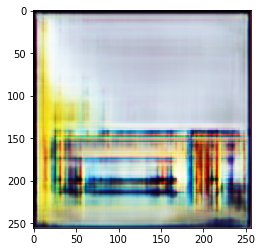

Epoch: 8
D Real: 0.07664647907382105
D Fake: 0.06451989737589185
G All:: 6.210768814286289


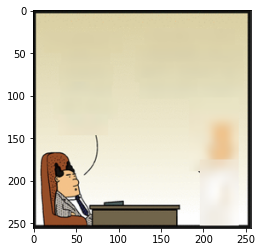

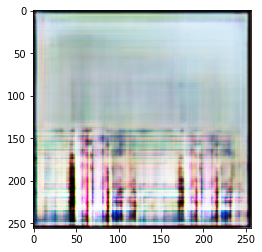

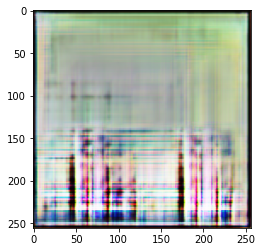

Epoch: 9
D Real: 0.07840229139926126
D Fake: 0.06916950008335429
G All:: 5.959764579862668


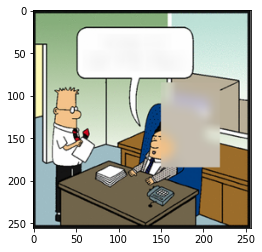

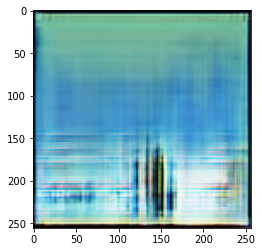

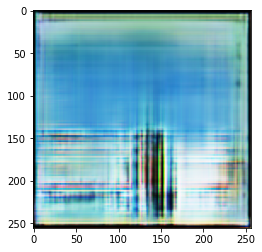

Epoch: 10
D Real: 0.07387772175233538
D Fake: 0.06349963343050007
G All:: 6.2290502308968465


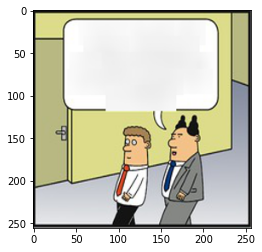

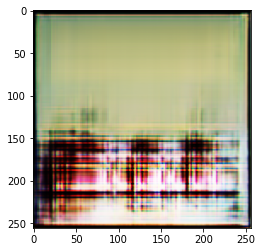

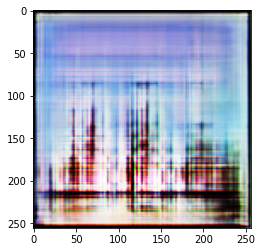

Epoch: 11
D Real: 0.07242045995458078
D Fake: 0.06560242137764596
G All:: 6.520772161384078


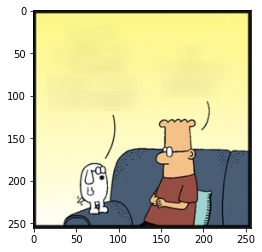

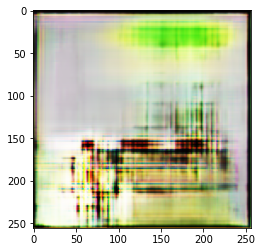

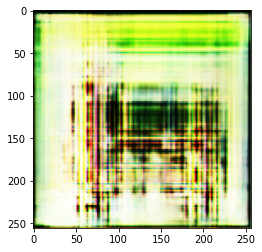

Epoch: 12
D Real: 0.06521038186674749
D Fake: 0.0572692708920311
G All:: 6.109542246064243


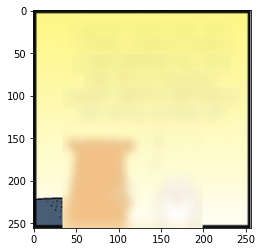

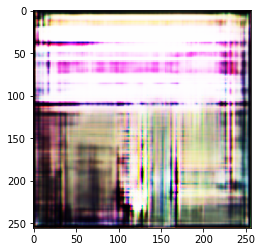

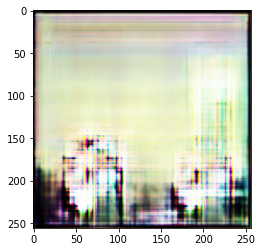

Epoch: 13
D Real: 0.0636150466232765
D Fake: 0.055921638910155676
G All:: 6.268837685369033


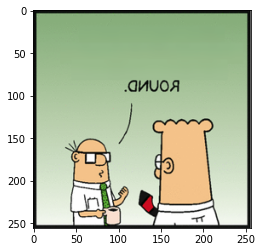

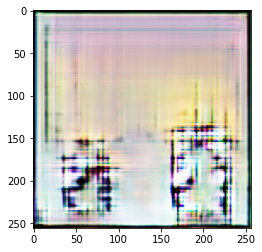

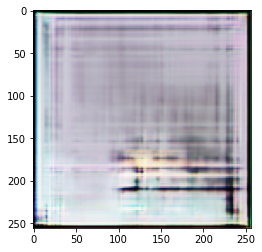

Epoch: 14
D Real: 0.10084397556059037
D Fake: 0.08743553631371115
G All:: 5.948657612767369


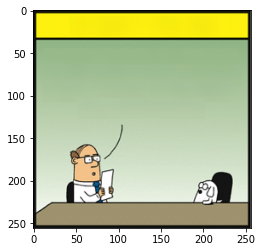

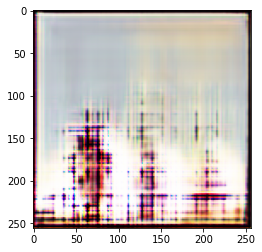

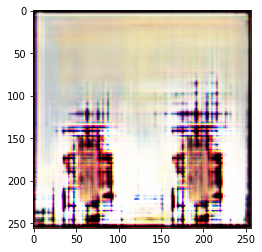

Epoch: 15
D Real: 0.06054048677614342
D Fake: 0.05141880980429957
G All:: 6.38430596228676


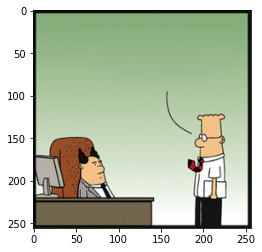

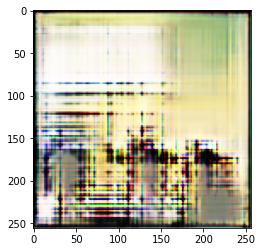

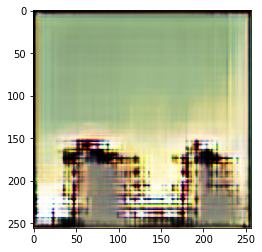

Epoch: 16
D Real: 0.07724178413688514
D Fake: 0.06610781258744437
G All:: 5.921615080550988


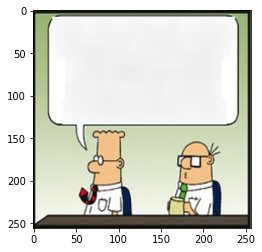

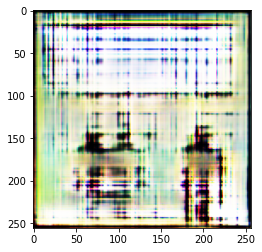

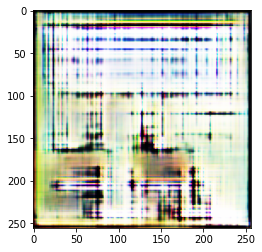

Epoch: 17
D Real: 0.0687650969570003
D Fake: 0.05817888822497391
G All:: 5.982676839994636


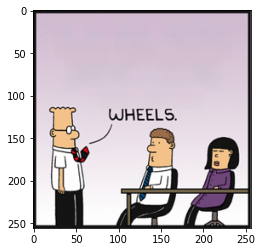

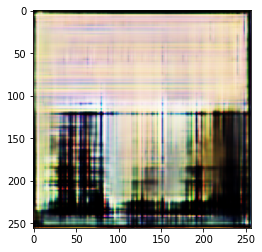

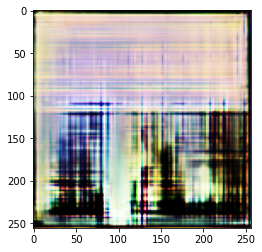

Epoch: 18
D Real: 0.07284007218864322
D Fake: 0.06600068267499735
G All:: 6.126151162988218


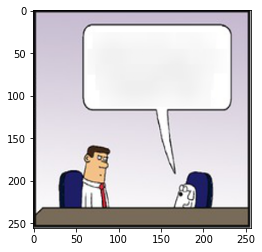

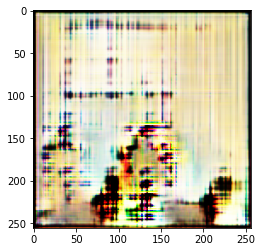

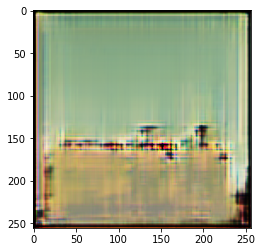

Epoch: 19
D Real: 0.07406094437951825
D Fake: 0.06452644000459423
G All:: 5.765058887129461


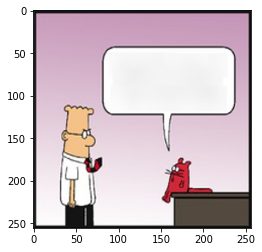

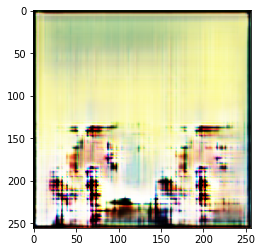

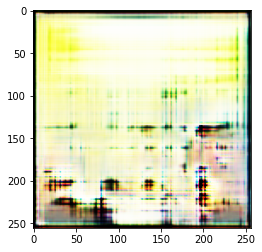

Epoch: 20
D Real: 0.07584861956069486
D Fake: 0.06992372629664294
G All:: 6.05963652640685


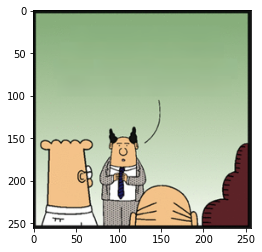

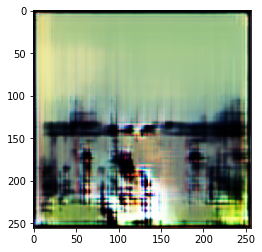

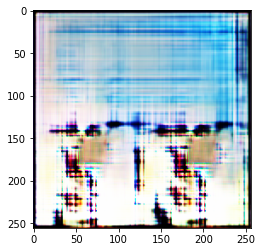

Epoch: 21
D Real: 0.06664150805968648
D Fake: 0.062013869228990236
G All:: 6.475671256460795


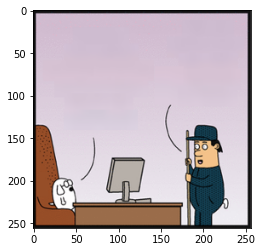

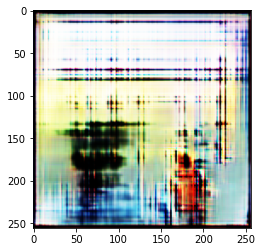

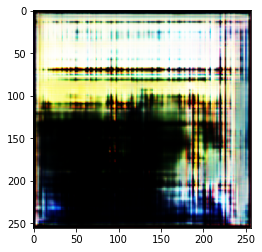

Epoch: 22
D Real: 0.06455142307338607
D Fake: 0.056764823322927496
G All:: 6.262425407715376


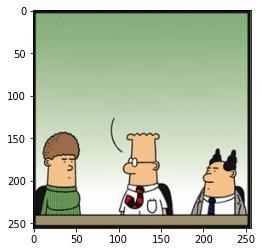

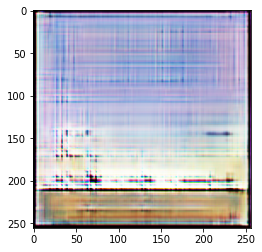

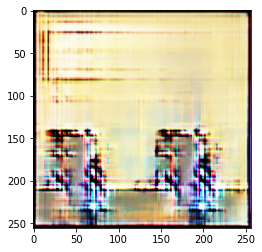

Epoch: 23
D Real: 0.059503521770238876
D Fake: 0.05026136874789145
G All:: 6.072869283397023


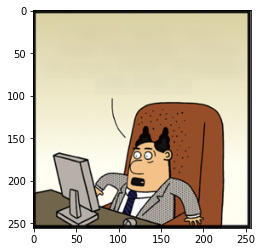

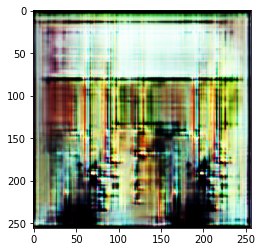

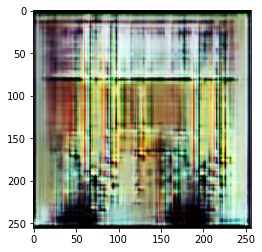

Epoch: 24
D Real: 0.07569685118850515
D Fake: 0.06448850434805665
G All:: 6.350462925974085


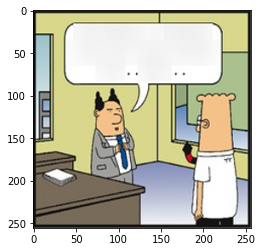

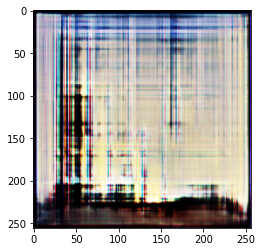

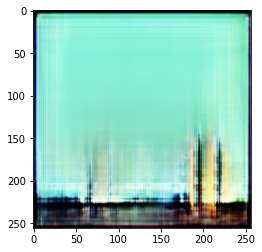

Epoch: 25
D Real: 0.06378278325113892
D Fake: 0.05361316553625288
G All:: 5.780855087453064


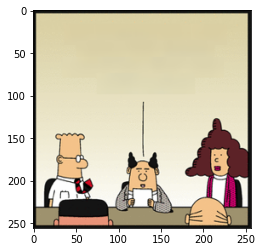

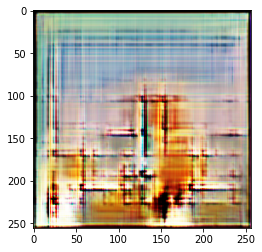

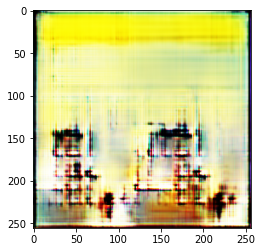

Epoch: 26
D Real: 0.07383635253337202
D Fake: 0.06473458205911133
G All:: 6.349484443664551


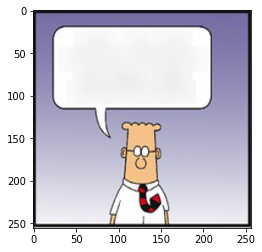

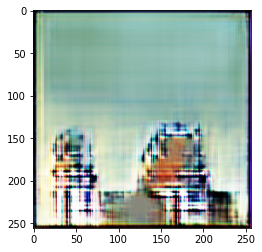

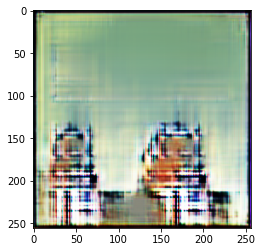

Epoch: 27
D Real: 0.06580766296267301
D Fake: 0.060774003269105425
G All:: 6.141635264669146


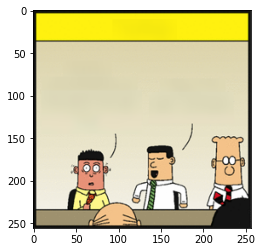

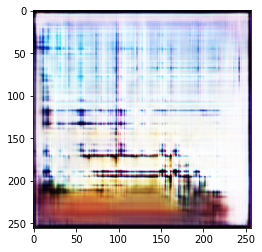

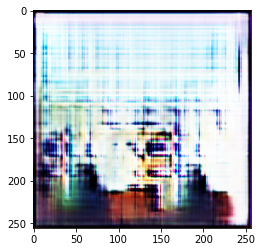

Epoch: 28
D Real: 0.06471194905790302
D Fake: 0.05626510240085657
G All:: 5.8712705556523925


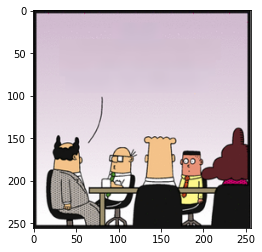

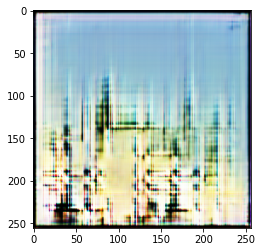

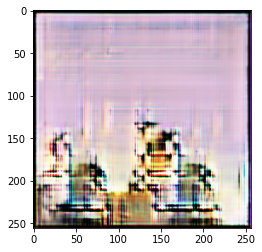

Epoch: 29
D Real: 0.06739232778704955
D Fake: 0.061868226720273284
G All:: 5.951745397953206


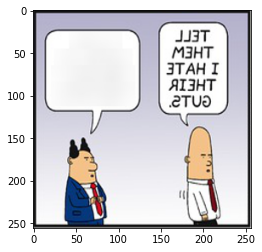

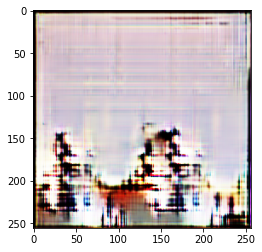

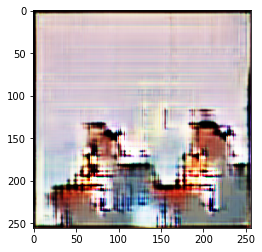

In [ ]:
model = Model_GAN_epochs()

# model.GAN.steps = 51234
# model.load(51)

print("We're off! See you in a while!")

max_epoch = 30

for epoch in range(max_epoch):

    model.epoch = epoch
    print("Epoch: "+ str(epoch))
    model.train()
    model.eval2(epoch)


# while(model.GAN.steps < 500000):
    
#     # print("\n\n\n\nRound " + str(model.GAN.steps) + ":")
#     model.train()
    
#     if model.GAN.steps % 1000 == 0:
#         print("\n\n\n\nRound " + str(model.GAN.steps) + ":")
#         model.eval2(int(model.GAN.steps / 1000))